# Capstone: K mean clustering flood index model 

In [1]:
# package
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import geopandas as gpd
import matplotlib.colors as colors
from sklearn.preprocessing import MinMaxScaler

# Import Data

In [2]:
# import data
df = pd.read_csv('MASTER_VARIABLES.csv')

# get variable names
data = df.drop(columns = ['object_id','district','rc_area','timeperiod'])
variable_names = data.columns.tolist()
print(variable_names)

['total_tender_awarded_value', 'SOPD_tenders_awarded_value', 'SDRF_tenders_awarded_value', 'RIDF_tenders_awarded_value', 'LTIF_tenders_awarded_value', 'CIDF_tenders_awarded_value', 'Preparedness Measures_tenders_awarded_value', 'Immediate Measures_tenders_awarded_value', 'Others_tenders_awarded_value', 'Total_Animal_Washed_Away', 'Total_Animal_Affected', 'Population_affected_Total', 'Crop_Area', 'Total_House_Fully_Damaged', 'Embankments affected', 'Roads', 'Bridge', 'Embankment breached', 'max_rain', 'mean_rain', 'sum_rain', 'mean_ndvi', 'ndbi_mean', 'inundation_pct', 'inundation_intensity_mean', 'inundation_intensity_mean_nonzero', 'inundation_intensity_sum', 'riverlevel_mean', 'riverlevel_min', 'riverlevel_max', 'Relief_Camp_inmates', 'Human_Live_Lost', 'mean_sexratio', 'sum_aged_population', 'sum_young_population', 'sum_population', 'water', 'trees', 'flooded_vegetation', 'crops', 'built_area', 'bare_ground', 'clouds', 'rangeland', 'schools_count', 'health_centres_count', 'rail_leng

# Exploratory Data Analysis

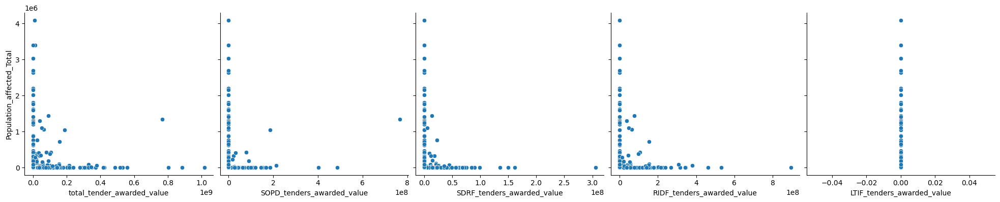

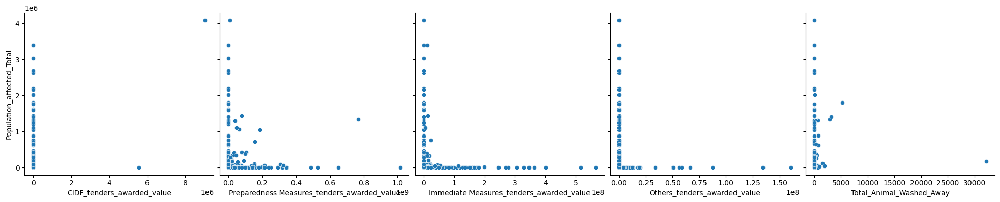

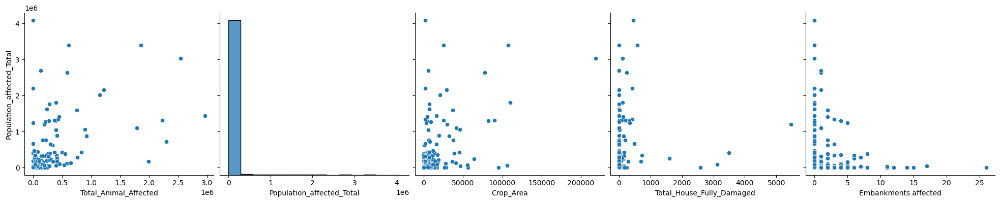

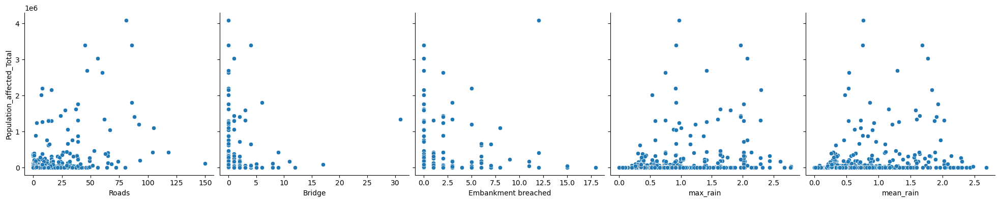

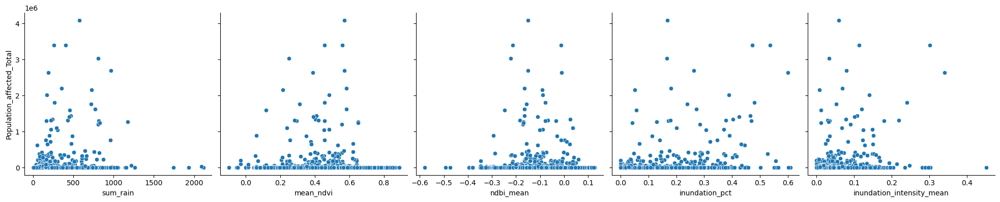

...

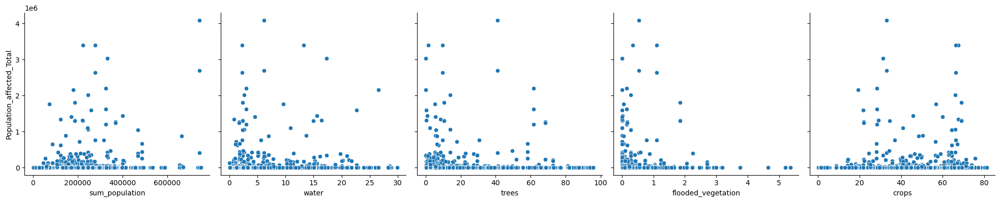

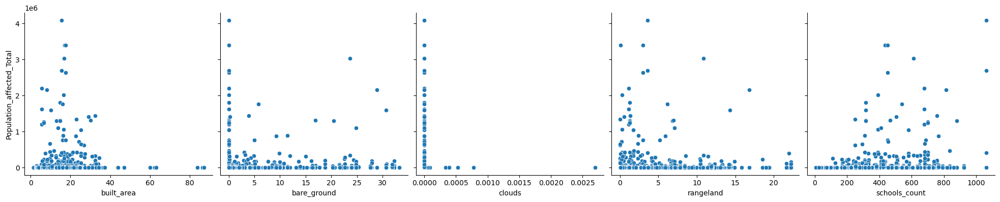

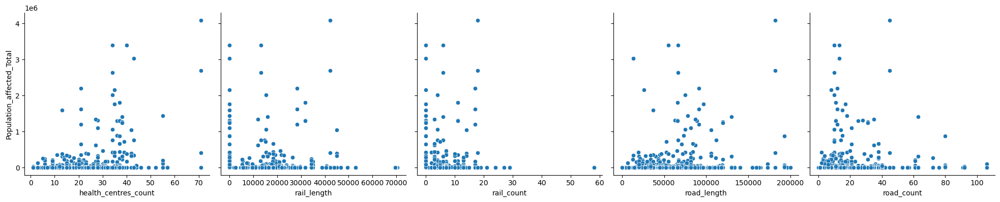

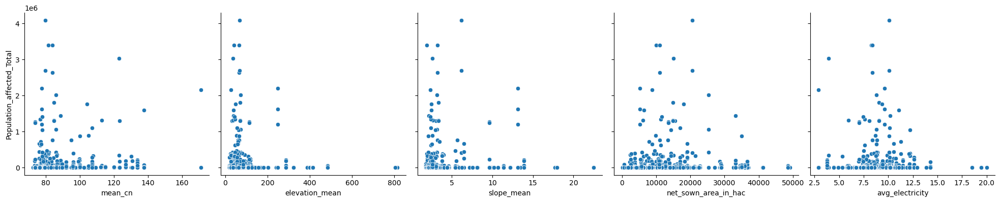

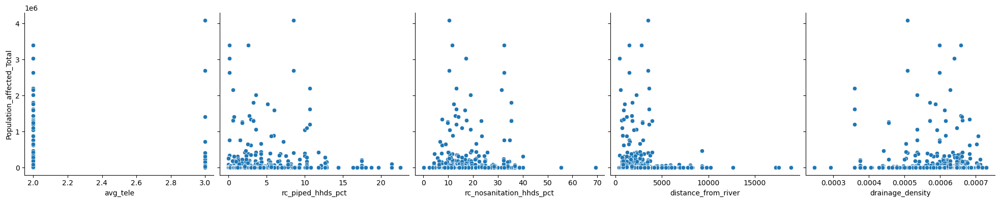

In [3]:
# pairwise plot for Population_affected_Total
y_name = "Population_affected_Total"
chunks = [data.columns[i:i + 5] for i in range(0, len(data.columns), 5)]
for chunk in chunks:
    sns.pairplot(data, y_vars=[y_name], x_vars=chunk, height=4)
    plt.show()

# Correlation Heatmap

<Axes: >

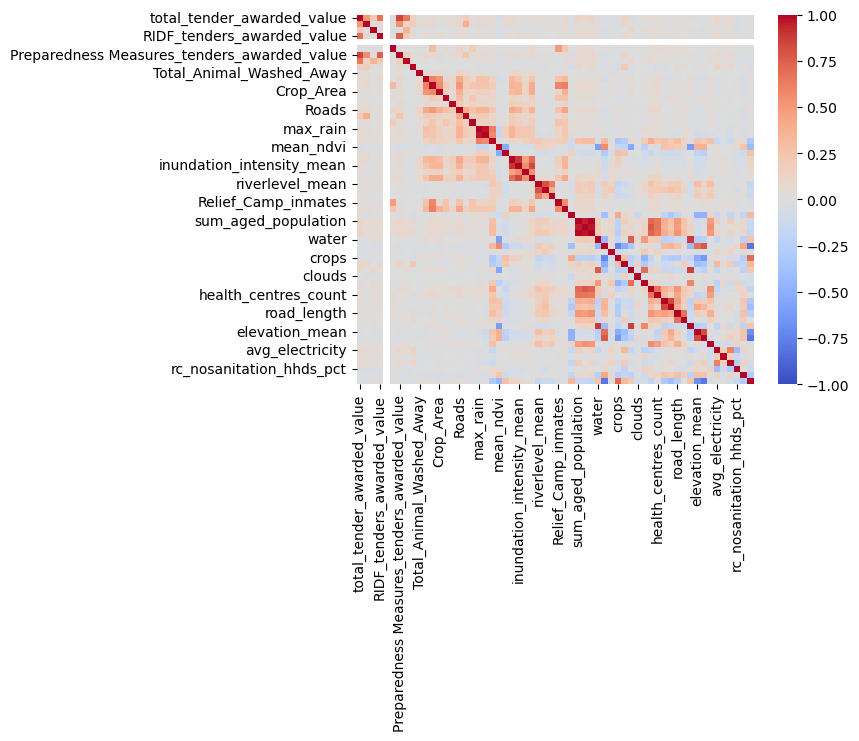

In [4]:
# correlation matrix
sns.heatmap(data.corr(), cmap='coolwarm', vmin=-1, vmax=1)

# Population distribution for Assam state

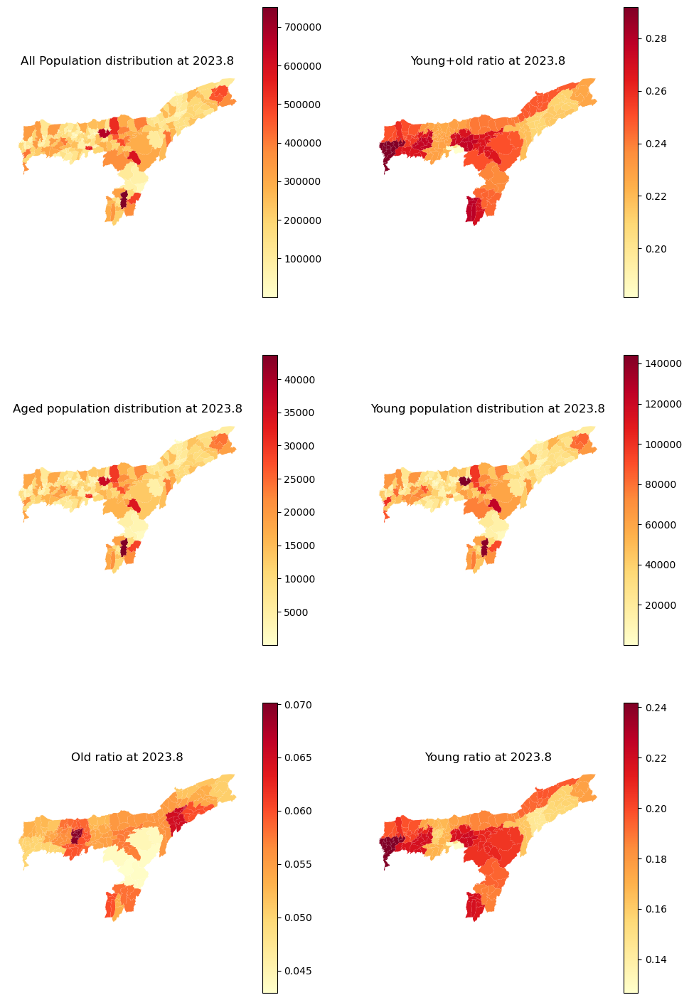

In [5]:
# check population distribution, also creating ratio number to check age ratio for each RC
age = df[['object_id', 'timeperiod', 'sum_aged_population','sum_young_population', 'sum_population']].copy()
age['old_ratio'] = age['sum_aged_population']/age['sum_population']
age['young_ratio'] = age['sum_young_population']/age['sum_population']
age['old&young_ratio'] = (age['sum_aged_population']+age['sum_young_population'])/age['sum_population']
age['timeperiod'] = pd.to_datetime(age['timeperiod'], format='%Y_%m')
age['year'] = age['timeperiod'].dt.year
age['month'] = age['timeperiod'].dt.month
# Filter most resent data
age = age[(age['year'] == 2023) & (age['month'] == 8)]
# Load geo map
gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
age = pd.DataFrame(age)
gdf['object_id'] = gdf['object_id'].astype(df['object_id'].dtype)
# Merge the geographic data with the age data on the 'object_id' column
age_merged = gdf.merge(age, on='object_id', how='left')

# plot
fig, ax = plt.subplots(3, 2, figsize=(12, 18))

# all population
age_merged.plot(column='sum_population', cmap='YlOrRd', ax=ax[0][0], legend=True)
ax[0][0].set_title(f"All Population distribution at 2023.8")
ax[0][0].set_axis_off()

# combined young and old population (vulnable population) ratio
age_merged.plot(column='old&young_ratio', cmap='YlOrRd', ax=ax[0][1], legend=True)
ax[0][1].set_title(f"Young+old ratio at 2023.8")
ax[0][1].set_axis_off()

# old population distribution
age_merged.plot(column='sum_aged_population', cmap='YlOrRd', ax=ax[1][0], legend=True)
ax[1][0].set_title(f"Aged population distribution at 2023.8")
ax[1][0].set_axis_off()

# young population distribution
age_merged.plot(column='sum_young_population', cmap='YlOrRd', ax=ax[1][1], legend=True)
ax[1][1].set_title(f"Young population distribution at 2023.8")
ax[1][1].set_axis_off()

# old ratio distribution
age_merged.plot(column='old_ratio', cmap='YlOrRd', ax=ax[2][0], legend=True)
ax[2][0].set_title(f"Old ratio at 2023.8")
ax[2][0].set_axis_off()

# young ratio distribution
age_merged.plot(column='young_ratio', cmap='YlOrRd', ax=ax[2][1], legend=True)
ax[2][1].set_title(f"Young ratio at 2023.8")
ax[2][1].set_axis_off()


# PCA


In [6]:
# Index grouping
pca_data = {
    'government_investment_index': [
        "total_tender_awarded_value",
        "Preparedness Measures_tenders_awarded_value",
        "Immediate Measures_tenders_awarded_value"
    ],

    'damage_index': [
        "Total_Animal_Affected",
        "Population_affected_Total",
        "Crop_Area",
        "Relief_Camp_inmates",
        "Human_Live_Lost",
        "Roads",
        "Bridge",
    ],

    'inundation_index' :[
        "inundation_pct",
        "inundation_intensity_mean",
        "inundation_intensity_mean_nonzero",
        "inundation_intensity_sum"
    ],

    'rain_index': [
        "max_rain",
        "mean_rain",
        "sum_rain"
    ],

    'river_index': [
        "riverlevel_mean",
        "riverlevel_min",
        "riverlevel_max",
    ],

    'infrastructure_population_index':[
        "health_centres_count",
        "schools_count",
        "sum_aged_population",
        "sum_young_population",
        "sum_population",
        "net_sown_area_in_hac",
    ],

    'road_index': [
        "rail_length",
        "rail_count",
        "road_length",
        "road_count"
    ],

    'terrain_index': [
        "slope_mean",
        "elevation_mean",
        "distance_from_river",
        "mean_ndvi",
        "trees"
    ],

    'land_index': [
        "bare_ground",
        "water",
        "rangeland",
        "mean_cn"
     ],

     'drainage_index': [
        "drainage_density",
        "crops"
    ],
    'electricity_index': [
    "avg_electricity"
    ]
}

In [7]:
top_20_correlations = {}
correlation_matrix = data.corr()

# Find top 20 correlations for each variable
for column in data.columns:
    # Sorting correlations in descending order (excluding the variable itself) and taking the top 20
    sorted_correlations = correlation_matrix[column].drop(column).sort_values(ascending=False).head(20)
    top_20_correlations[column] = sorted_correlations
# Set the threshold to be 0.4 as high_correlation_groups.
high_correlation_groups = {}
for variable, correlations in top_20_correlations.items():
    # Filtering correlations greater than 0.4
    high_correlation_vars = correlations[correlations > 0.4].index.tolist()
    if high_correlation_vars:
        high_correlation_groups[variable] = high_correlation_vars
        
# Delete redundant variables based on the most important variables
pca_index = [
    'total_tender_awarded_value',
    'Population_affected_Total',
    'inundation_pct',
    'max_rain',
    'riverlevel_mean',
    'health_centres_count',
    'rail_length',
    'trees',
    'bare_ground',
    'drainage_density',
    'avg_electricity' 
]

to_delete = []

# Identify redundant variables for deletion
for i in pca_index:
    if i in high_correlation_groups:  # Check if i is a valid key
        for j in high_correlation_groups[i]:
            if j in high_correlation_groups and j not in to_delete:
                to_delete.append(j)
to_delete = list(set(to_delete))
# Now delete the keys outside the loop
for i in to_delete:
    del high_correlation_groups[i]
    

In [8]:
pca_results_corrected = {}
for factor, columns in pca_data.items():
    # Standardize the data
    scaler = StandardScaler()
    standardized_data = scaler.fit_transform(df[columns].fillna(0))
    # Perform PCA
    pca = PCA(n_components=1)  # We are reducing to 1 component for simplicity
    pca_results_corrected[factor] = pca.fit_transform(standardized_data)

# Combine the corrected results into a single DataFrame
pca_factors= pd.DataFrame({factor: pca_results_corrected[factor].flatten() for factor in pca_results_corrected})

# Show the resulting DataFrame with corrected PCA factors
pca_factors.columns

Index(['government_investment_index', 'damage_index', 'inundation_index',
       'rain_index', 'river_index', 'infrastructure_population_index',
       'road_index', 'terrain_index', 'land_index', 'drainage_index',
       'electricity_index'],
      dtype='object')

# Add back object_id and timeperiod

In [9]:
# Prepare the independent variables (PCA factors) and the dependent variable (damage index)
pca_factors['object_id'] = df['object_id']
pca_factors['timeperiod'] = df['timeperiod']
pca_factors['timeperiod'] = pd.to_datetime(pca_factors['timeperiod'], format='%Y_%m')

# K mean clustering

In [10]:

def apply_kmeans(data, variables, column_name,  n_clusters=6, normalize=True):
    """
    Apply K-Means clustering to specified variables in the dataframe.

    Parameters:
    - data: Input dataframe
    - variables: List of variables to be included in clustering
    - column_name: name of the new column
    - n_clusters: Number of clusters for K-Means (default is 3)
    - normalize: Boolean flag to indicate whether to normalize the data (default is True)

    Returns:
    - Dataframe with an additional column 'cluster' indicating the cluster assignment
    """
    # Selecting specified variables
    data_for_clustering = data[variables]

    # Normalizing the data if required
    if normalize:
        scaler = StandardScaler()
        data_for_clustering = scaler.fit_transform(data_for_clustering)

    # Apply K-Means
    kmeans = KMeans(n_clusters=n_clusters, random_state=0)
    clusters = kmeans.fit_predict(data_for_clustering)

    # Add the cluster labels to the original dataframe
    data[column_name] = clusters

    return data

# Apply K-Means to pca_factors with selected variables
clustered_data = apply_kmeans(pca_factors, variables = ['government_investment_index', 'inundation_index',
                                                        'damage_index',
       'rain_index', 'river_index', 'infrastructure_population_index',
       'road_index', 'terrain_index', 'land_index', 'drainage_index',
       'electricity_index'], column_name = 'flood_index')

/Users/tom/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


# Mannually label each cluster group

In [11]:
# checking group mean for each index
mean_damage_per_cluster = clustered_data.groupby('flood_index')['damage_index'].mean()
print(mean_damage_per_cluster)
mean_government_per_cluster = clustered_data.groupby('flood_index')['government_investment_index'].mean()
print(mean_government_per_cluster)
mean_inundation_per_cluster = clustered_data.groupby('flood_index')['inundation_index'].mean()
print(mean_inundation_per_cluster)
mean_rain_per_cluster = clustered_data.groupby('flood_index')['rain_index'].mean()
print(mean_rain_per_cluster)


flood_index
0   -0.218028
1   -0.136433
2    4.392024
3   -0.227074
4   -0.221582
5    1.041809
Name: damage_index, dtype: float64
flood_index
0    -0.198018
1     0.028918
2     0.168125
3    -0.170049
4    -0.012832
5    15.094669
Name: government_investment_index, dtype: float64
flood_index
0   -0.427203
1   -0.191756
2    5.743177
3   -0.265159
4   -0.264007
5    0.614875
Name: inundation_index, dtype: float64
flood_index
0    0.010394
1   -0.012282
2    2.882886
3   -0.314354
4    0.061401
5    0.328716
Name: rain_index, dtype: float64


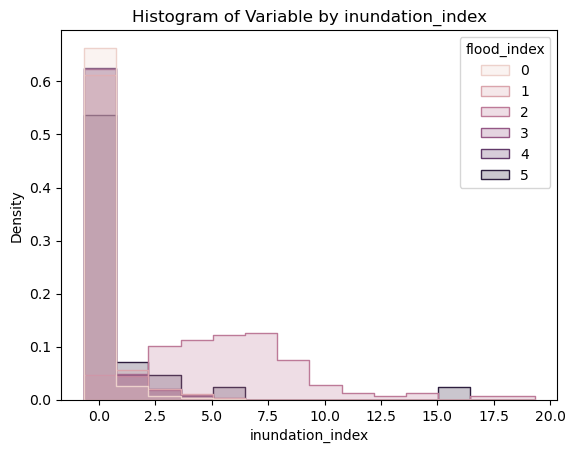

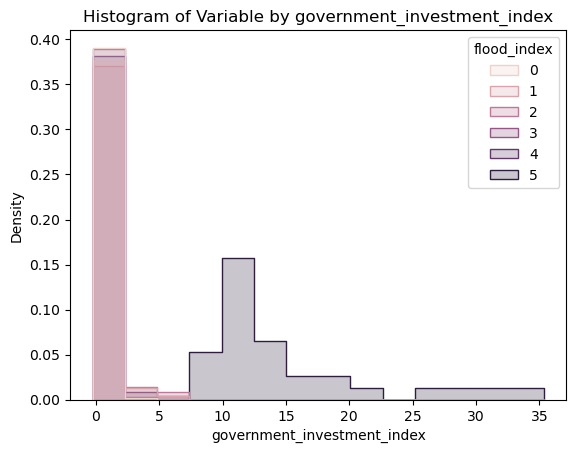

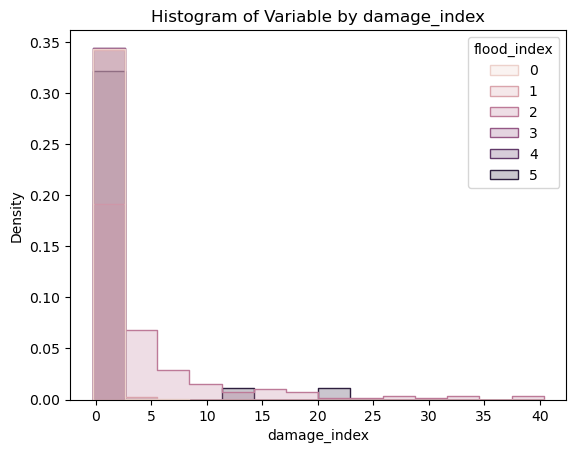

In [12]:
# Plotting histograms for different indices in the clustered data

# Histogram for inundation_index
# Histogram shows distribution of inundation_index values across different flood_index clusters
sns.histplot(clustered_data, x=clustered_data['inundation_index'], hue='flood_index', element='step', stat='density', common_norm=False)
plt.title('Histogram of Variable by inundation_index')
plt.show()

# Histogram for government_investment_index
# Histogram shows distribution of government_investment_index values across different flood_index clusters
sns.histplot(clustered_data, x=clustered_data['government_investment_index'], hue='flood_index', element='step', stat='density', common_norm=False)
plt.title('Histogram of Variable by government_investment_index')
plt.show()

# Histogram for damage_index
# Histogram shows distribution of damage_index values across different flood_index clusters
sns.histplot(clustered_data, x=clustered_data['damage_index'], hue='flood_index', element='step', stat='density', common_norm=False)
plt.title('Histogram of Variable by damage_index')
plt.show()


# Draw Flood index from K mean clustering

In [13]:
# Define a function to draw risk assessment maps
def draw_risk(data, object_id, index, year, month, classification_axis):
    # Load geographic data
    gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
    df = pd.DataFrame(data)
    # Ensure matching data types for merging
    gdf[object_id] = gdf[object_id].astype(df[object_id].dtype)
    # Merge geographic and provided data
    gdf_merged = gdf.merge(df, on=object_id, how='left')

    # Define risk categories and colormap
    categories = [0, 1, 2, 3, 4, 5, 6]
    labels = ['very low', 'low', 'median', 'high', 'very high', 'extreme']
    cmap = colors.ListedColormap(['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#7F0000'])
    norm = colors.BoundaryNorm(boundaries=categories, ncolors=len(categories))

    # Classify risks based on index
    gdf_merged['risk_category'] = pd.Categorical(pd.cut(gdf_merged[index],
                                                        bins=[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5],
                                                        labels=labels,
                                                        include_lowest=True,
                                                        ordered=True))
    # Plot the map with risk categories
    fig, ax = plt.subplots(1, 1)
    gdf_merged.plot(column='risk_category', ax=ax, legend=True, cmap=cmap, norm=norm,
                    legend_kwds={'loc': 'lower right'})
    ax.set_title(f"Revenue Circles by {year}.{month}, with {classification_axis} {round(np.mean(data[classification_axis]),4)}")
    ax.set_axis_off()
    plt.show()

Mean summed_score:  flood_index
0    0.122201
1    0.140989
2    0.728957
3    0.111168
4    0.138577
5    0.654213
Name: summed_score, dtype: float64
Group order:  flood_index
3    1
0    2
4    3
1    4
5    5
2    6
Name: summed_score, dtype: int64


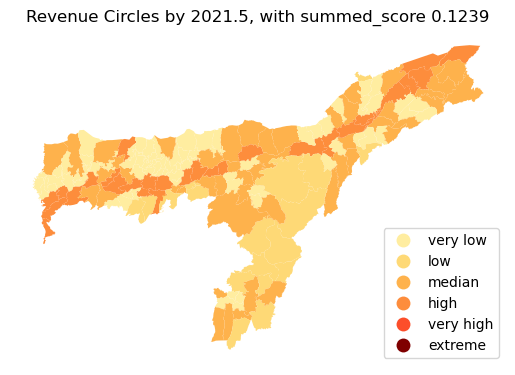

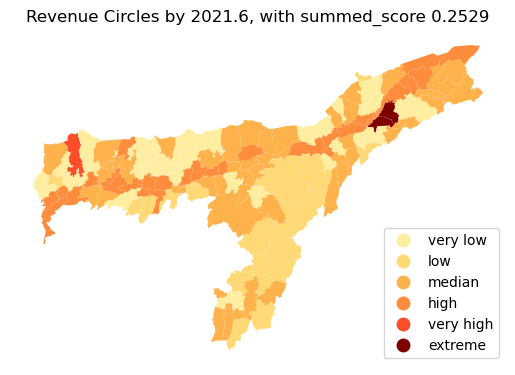

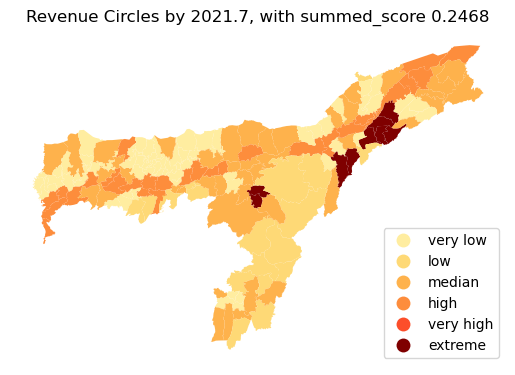

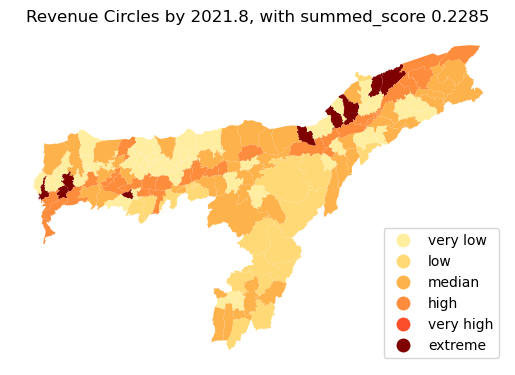

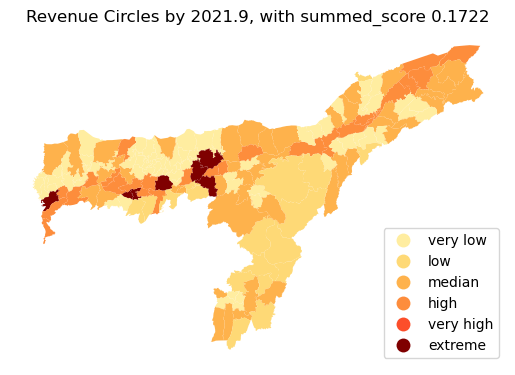

...

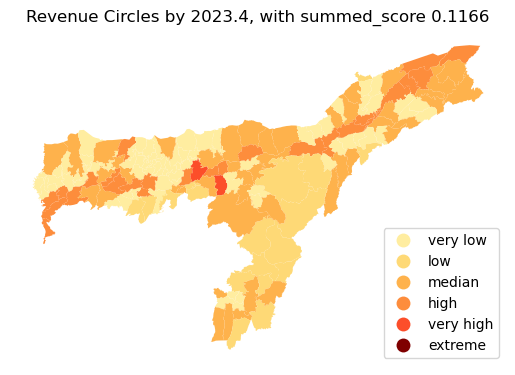

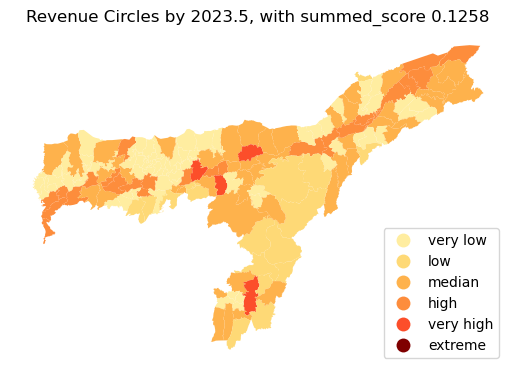

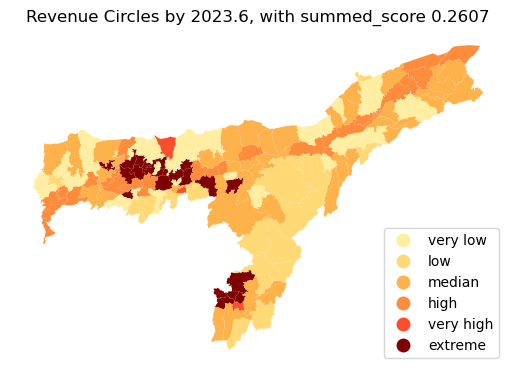

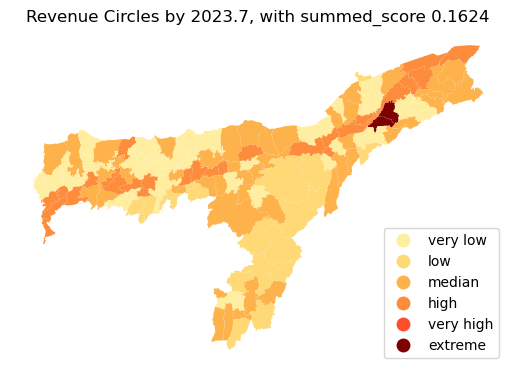

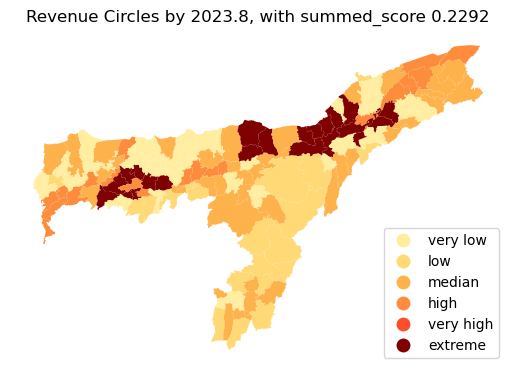

In [14]:
# Data preparation steps for risk mapping
# Extract year and month from timeperiod
clustered_data['timeperiod'] = pd.to_datetime(clustered_data['timeperiod'], format='%Y_%m')
clustered_data['year'] = clustered_data['timeperiod'].dt.year
clustered_data['month'] = clustered_data['timeperiod'].dt.month

# Binary classification for tender to check if RC is invested
df['tender'] = df['total_tender_awarded_value'].apply(lambda x: 1 if x > 0 else 0)
df['tender'] = df['tender'].replace({1: 'invested', 0: 'not invested'})

# Select relevant columns to merge with k mean result
selected_df = df[['object_id', 'timeperiod', 'tender', 'sum_rain', 'inundation_pct', 'inundation_intensity_mean', 'total_tender_awarded_value']].copy()
selected_df['timeperiod'] = pd.to_datetime(selected_df['timeperiod'], format='%Y_%m')

# Merge clustered data with selected data
merged_data = pd.merge(clustered_data, selected_df, on=['timeperiod', 'object_id'])
merged_data['total_tender_awarded_value'] = -merged_data['total_tender_awarded_value']

# Adjust index range for better plot
indices_to_change_range = ['government_investment_index', 'damage_index', 'inundation_index',
                          'rain_index', 'river_index', 'infrastructure_population_index',
                          'road_index', 'terrain_index', 'land_index', 'drainage_index',
                          'electricity_index','total_tender_awarded_value']

for column in indices_to_change_range:
    scaler = MinMaxScaler()
    merged_data[column] = scaler.fit_transform(merged_data[[column]])

indices_to_sum = ['government_investment_index', 'damage_index', 'inundation_index', 'rain_index']

# Summarize selected indices into a single score to generate a classification axis
merged_data['summed_score'] = merged_data[indices_to_sum].sum(axis=1)

# Adjust cluster label based on average values
classification_axis = 'summed_score'
mean_per_cluster = merged_data.groupby('flood_index')[classification_axis].mean()
print(f'Mean {classification_axis}: ', mean_per_cluster)
order = mean_per_cluster.sort_values().rank().astype(int)
cluster_mapping = {old_index: new_index for old_index, new_index in zip(order.index, order.values)}
print(f'Group order: ', order)
merged_data['flood_index_adjusted'] = merged_data['flood_index'].map(cluster_mapping)

# Generate risk maps for each year and month
for year in [2021,2022, 2023]:
    for month in range(1,13):
        filtered_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        if filtered_data.shape[0] > 0:
            draw_risk(filtered_data, 'object_id', 'flood_index_adjusted', year, month, classification_axis)


# Draw Flood index and tender allocation map to make a comparison

/var/folders/nj/g620cq492w98l83np35pmxb00000gn/T/ipykernel_9293/1833969842.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 2, figsize=(12, 6))


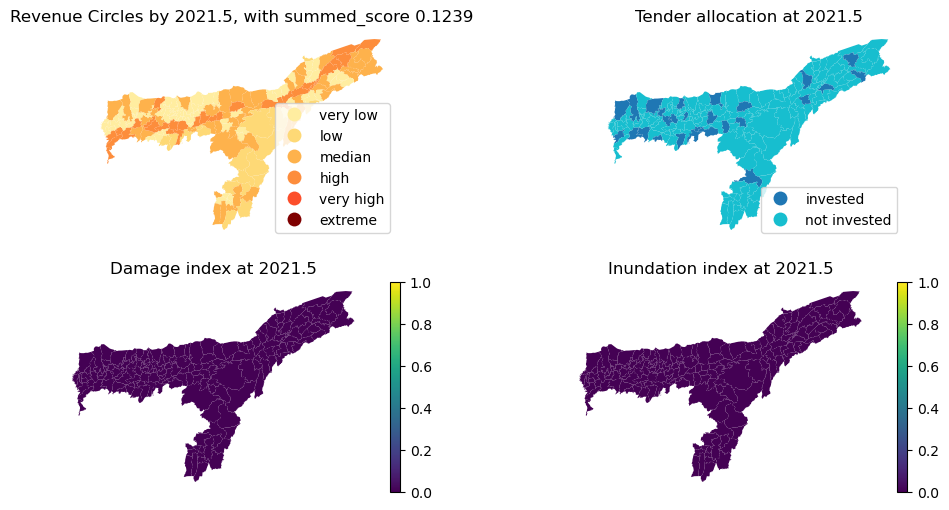

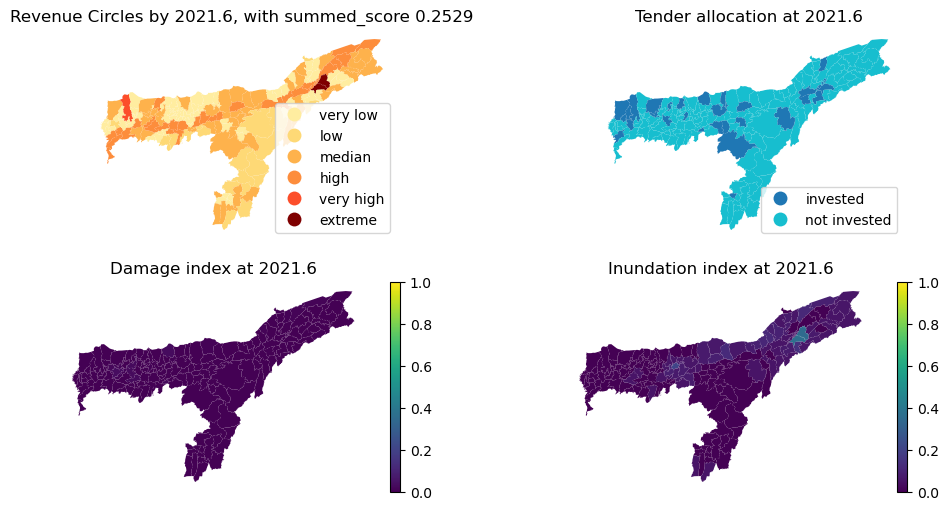

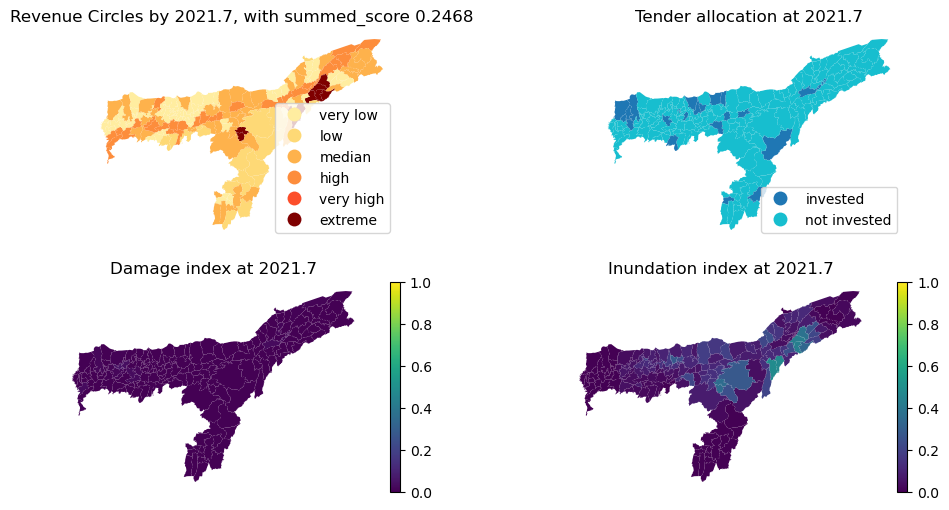

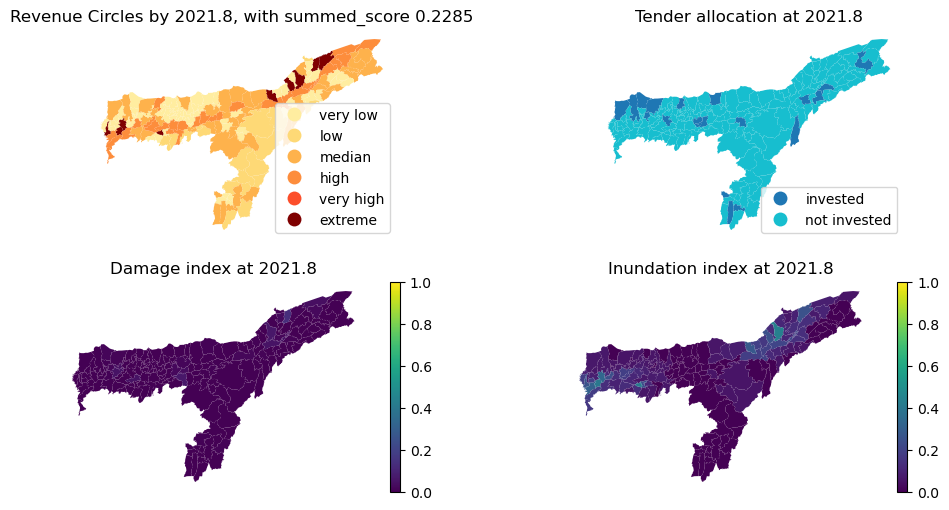

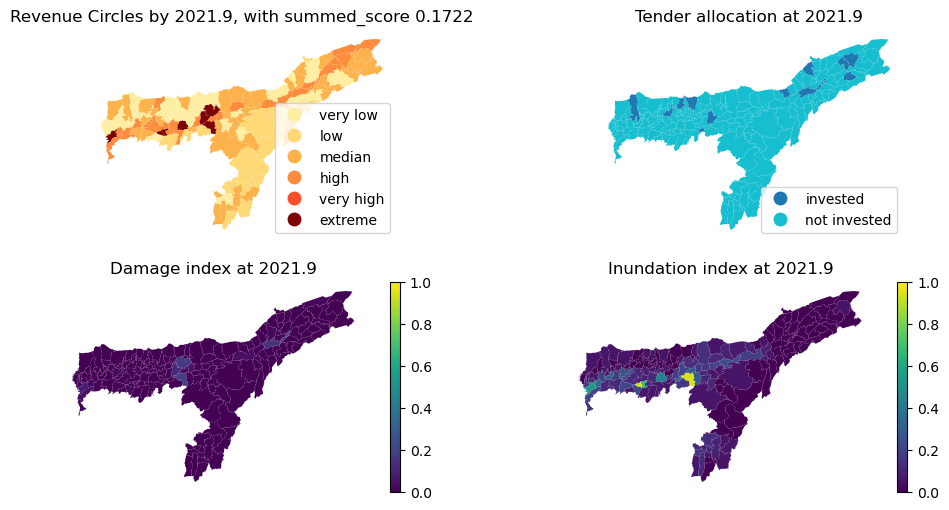

...

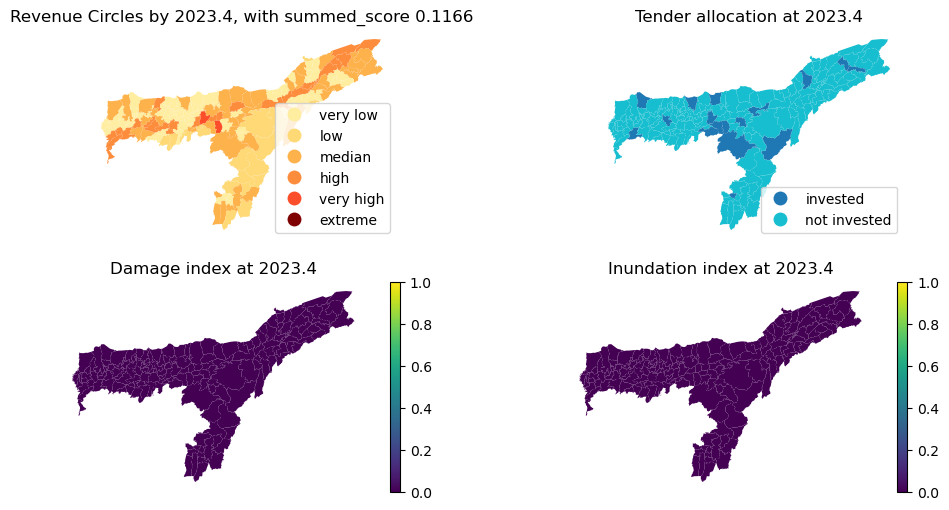

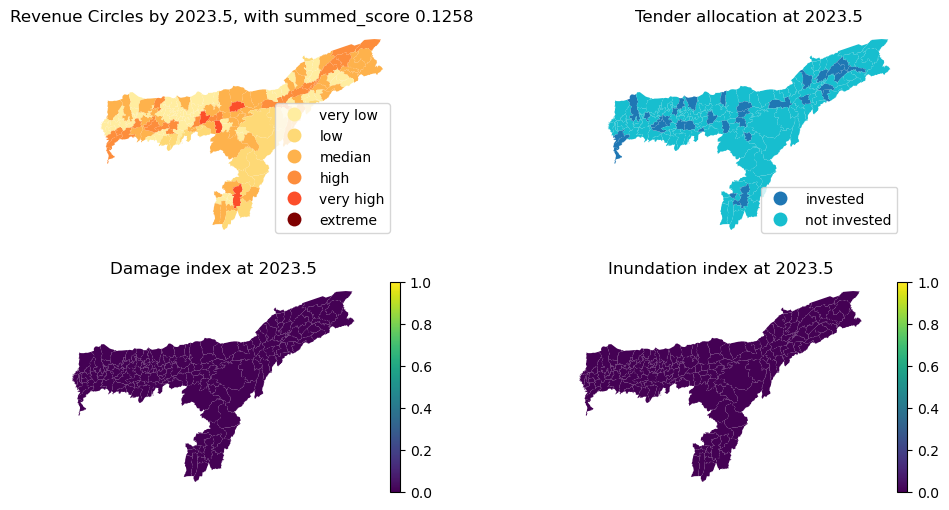

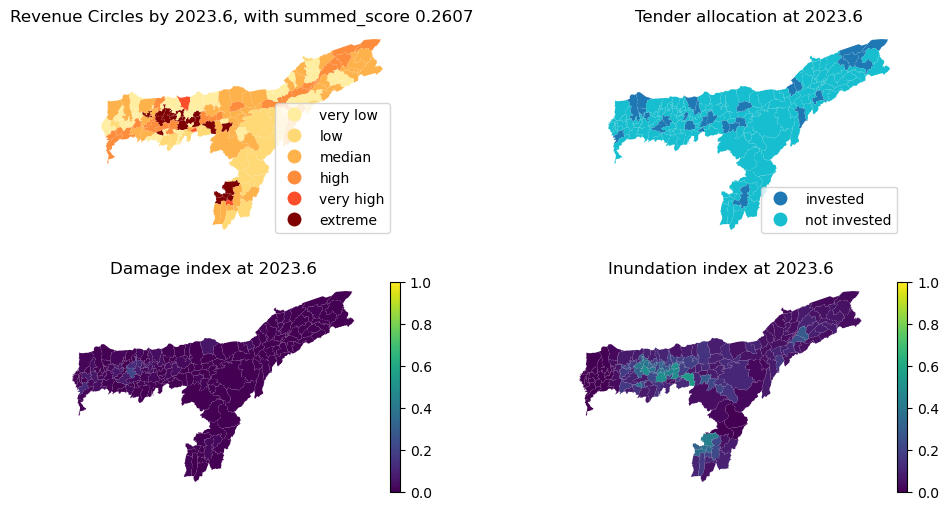

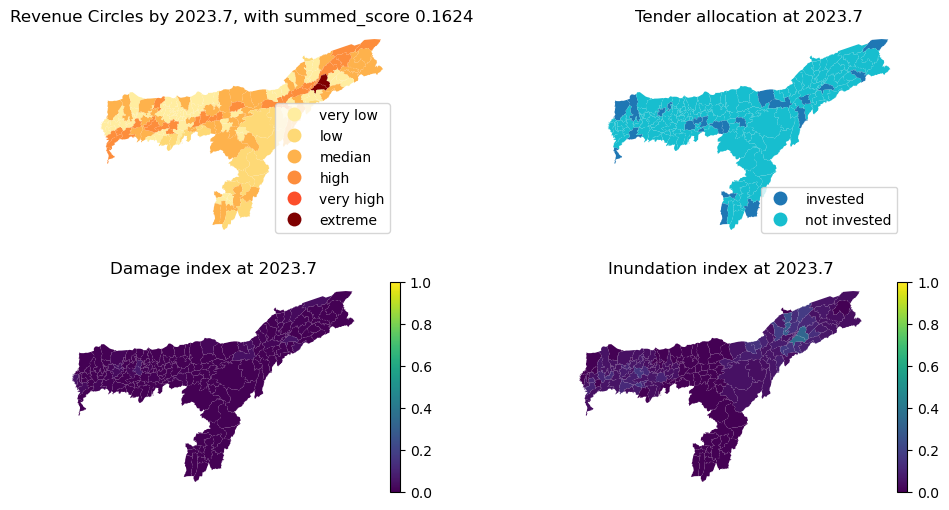

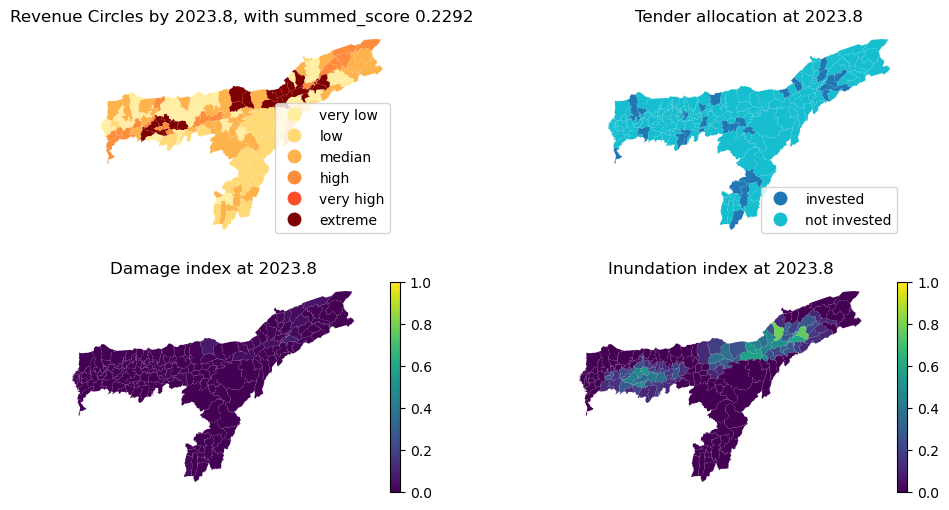

In [15]:
min_inundation_index = np.min(merged_data['inundation_index'])
max_inundation_index = np.max(merged_data['inundation_index'])
min_damage_index = np.min(merged_data['damage_index'])
max_damage_index = np.max(merged_data['damage_index'])

def draw_tender(data, object_id, index, year, month, classification_axis):
    # Load geospatial data
    gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
    # Convert input data to DataFrame
    df = pd.DataFrame(data)
    # Ensure data types match for merging
    gdf[object_id] = gdf[object_id].astype(df[object_id].dtype)
    # Merge geospatial data with input data
    gdf_merged = gdf.merge(df, on=object_id, how='left')

    # Set up risk categories and colormap
    categories = [0, 1, 2, 3, 4, 5, 6]
    labels = ['very low', 'low', 'median', 'high', 'very high', 'extreme']
    cmap = colors.ListedColormap(['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#7F0000'])
    norm = colors.BoundaryNorm(boundaries=categories, ncolors=len(categories))

    # Categorize risk levels
    gdf_merged['risk_category'] = pd.Categorical(pd.cut(gdf_merged[index],
                                                        bins=[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5],
                                                        labels=labels,
                                                        include_lowest=True,
                                                        ordered=True))
    # Create subplots
    fig, ax = plt.subplots(2, 2, figsize=(12, 6))
    # Plot risk categories
    gdf_merged.plot(column='risk_category', ax=ax[0][0], legend=True, cmap=cmap, norm=norm, legend_kwds={'loc': 'lower right'})
    ax[0][0].set_title(f"Revenue Circles by {year}.{month}, with {classification_axis} {round(np.mean(data[classification_axis]), 4)}")
    ax[0][0].set_axis_off()

    # Plot tender allocation
    gdf_merged.plot(column='tender', ax=ax[0][1], legend=True, legend_kwds={'loc': 'lower right'})
    ax[0][1].set_title(f"Tender allocation at {year}.{month}")
    ax[0][1].set_axis_off()

        # Plot damage index map
    gdf_merged.plot(column='damage_index', ax=ax[1][0], legend=True, vmin=min_damage_index, vmax=max_damage_index)
    ax[1][0].set_title(f"Damage index at {year}.{month}")
    ax[1][0].set_axis_off()

    # Plot inundation index map
    gdf_merged.plot(column='inundation_index', ax=ax[1][1], legend=True, vmin=min_inundation_index, vmax=max_inundation_index)
    ax[1][1].set_title(f"Inundation index at {year}.{month}")
    ax[1][1].set_axis_off()

# Loop through years and months to draw the tender and risk maps
for year in [2021, 2022, 2023]:
    for month in range(1, 13):
        # Filter data for specific year and month
        filtered_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        # Check if there is data to plot
        if filtered_data.shape[0] > 0:
            draw_tender(filtered_data, 'object_id', 'flood_index_adjusted', year, month, classification_axis)


# Draw Flood index, inundation_index, damage_index, and rain_index to make a comparison

/var/folders/nj/g620cq492w98l83np35pmxb00000gn/T/ipykernel_9293/299050174.py:33: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 2, figsize=(12, 12))


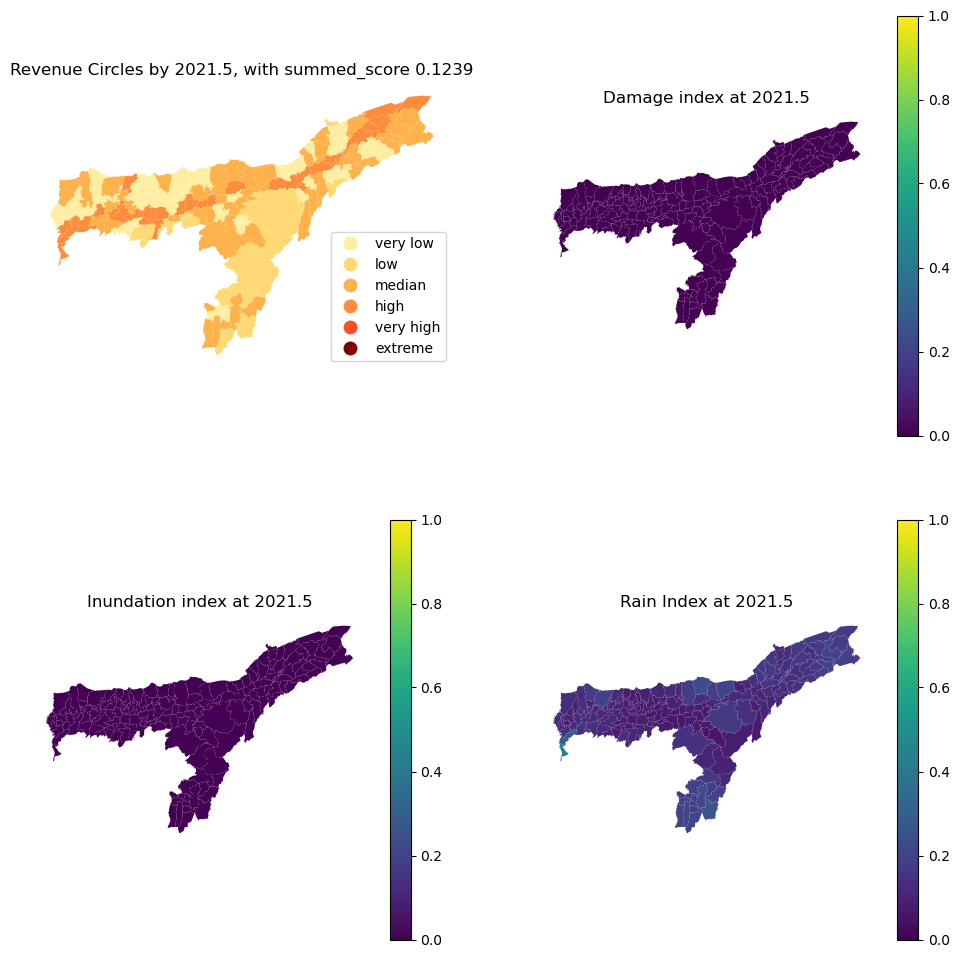

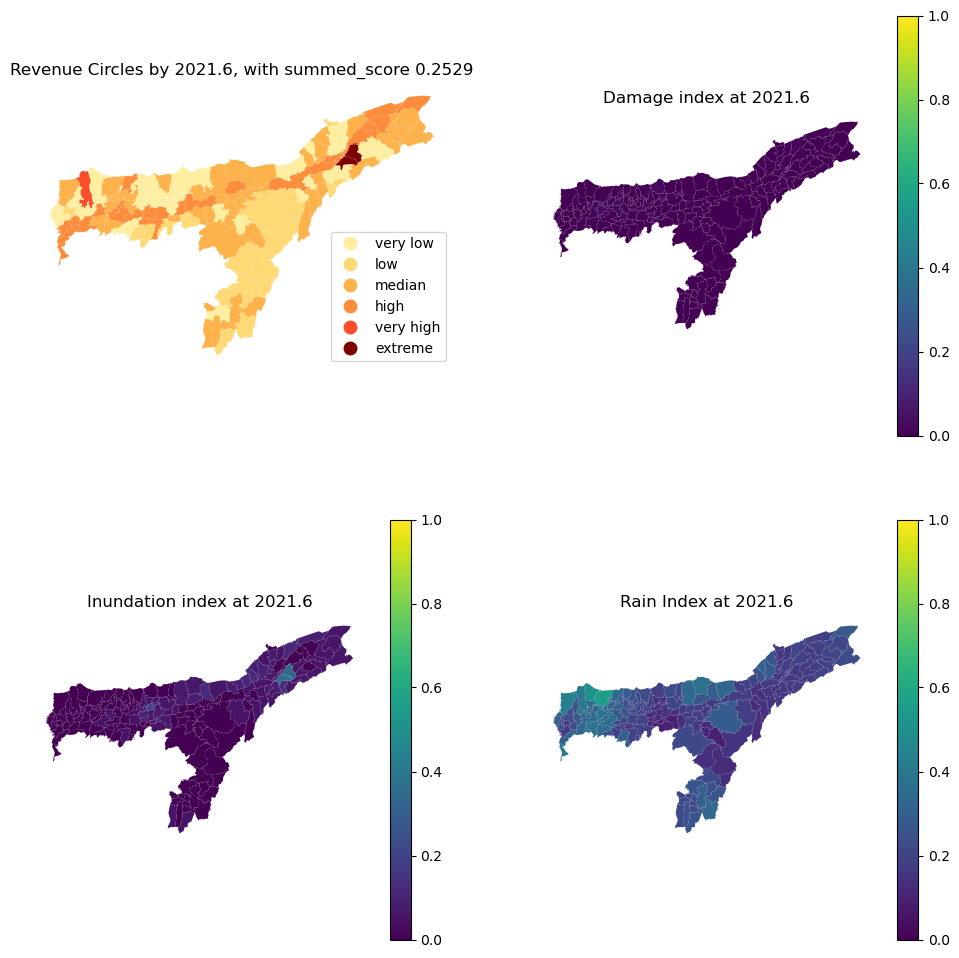

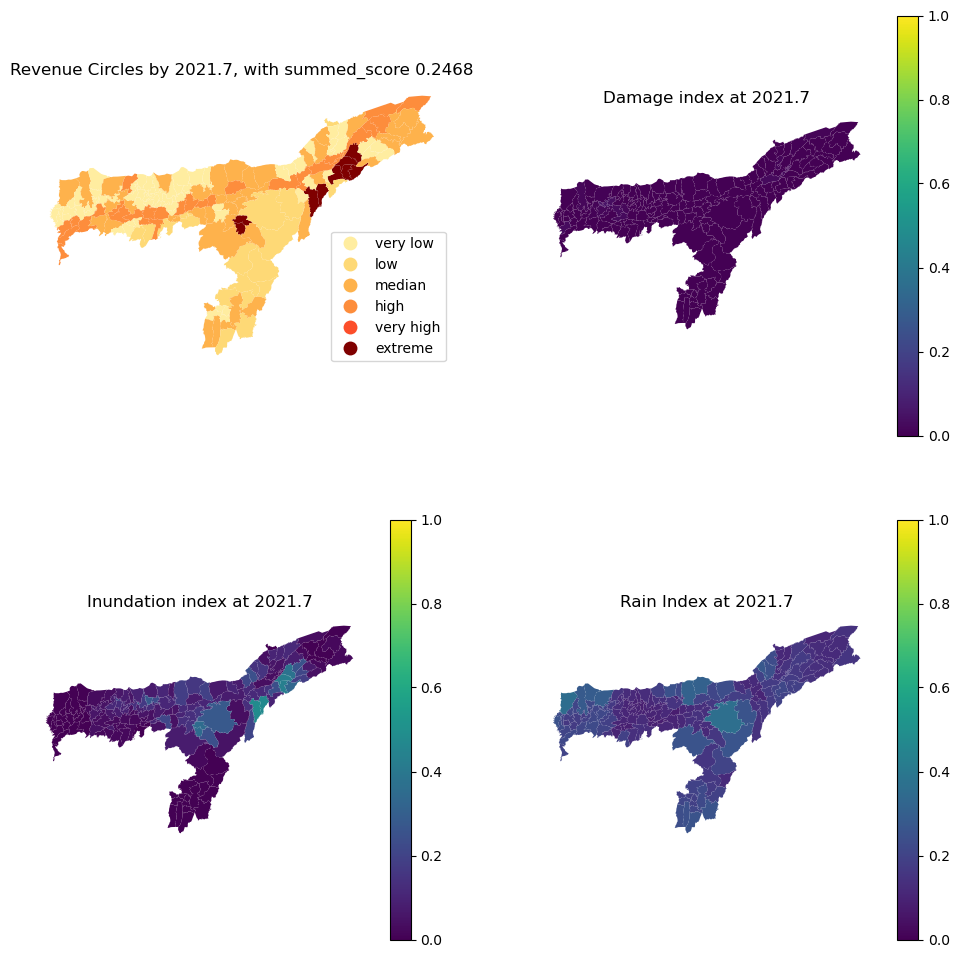

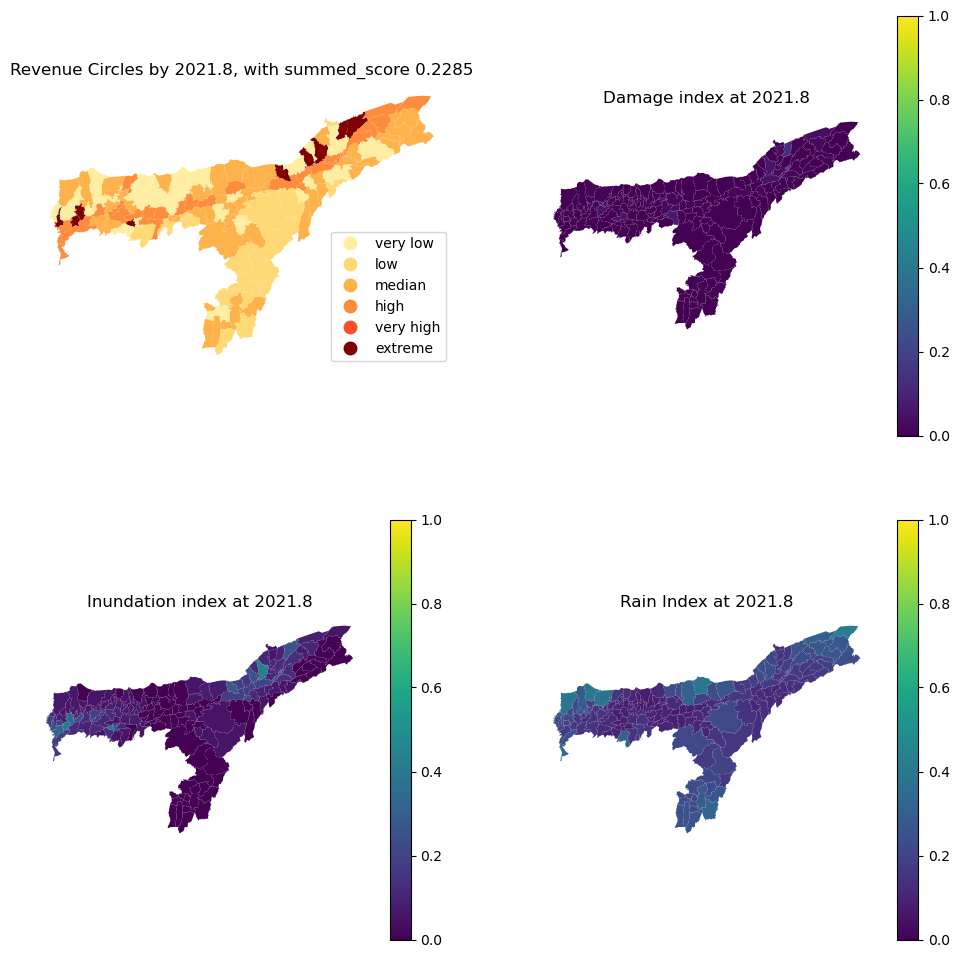

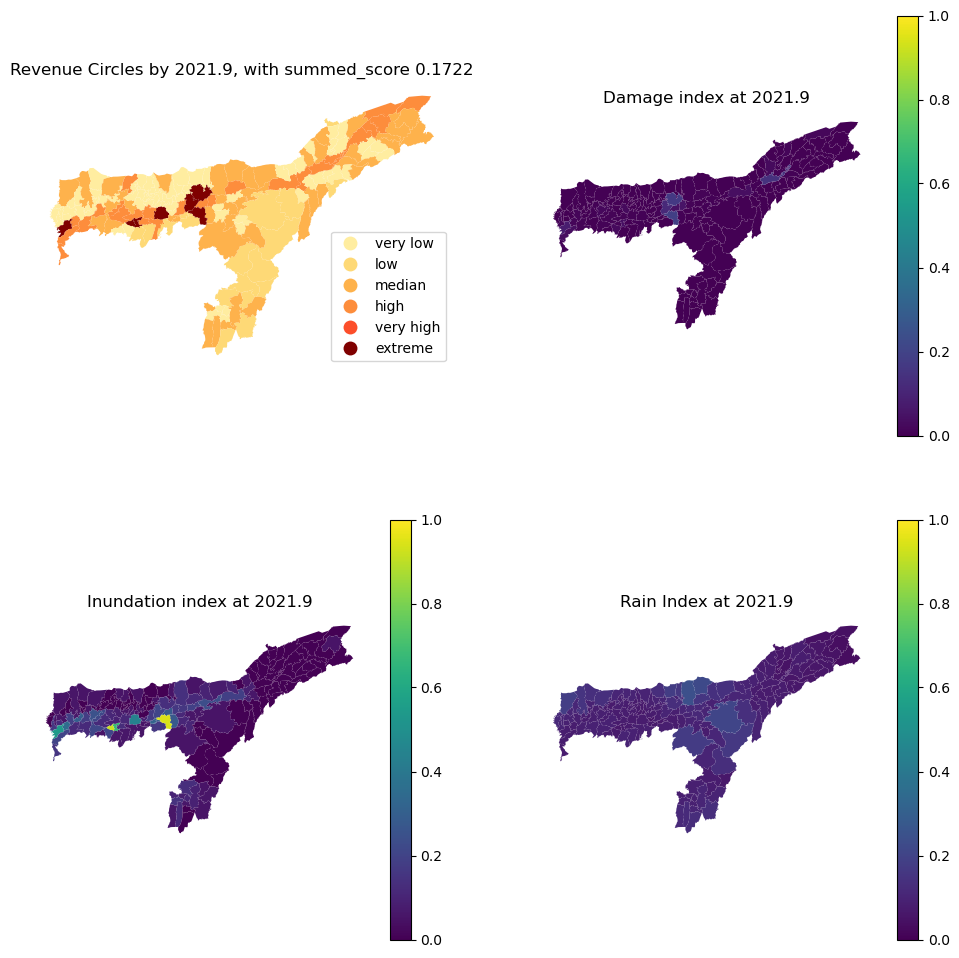

...

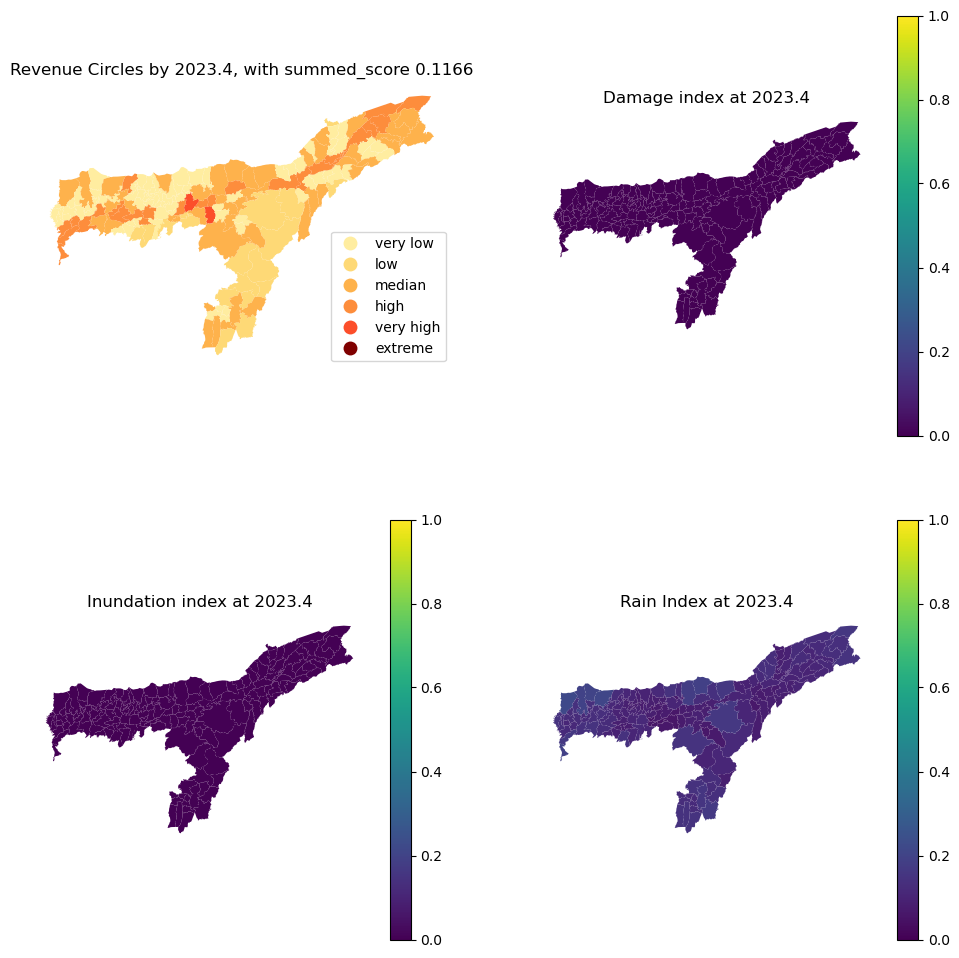

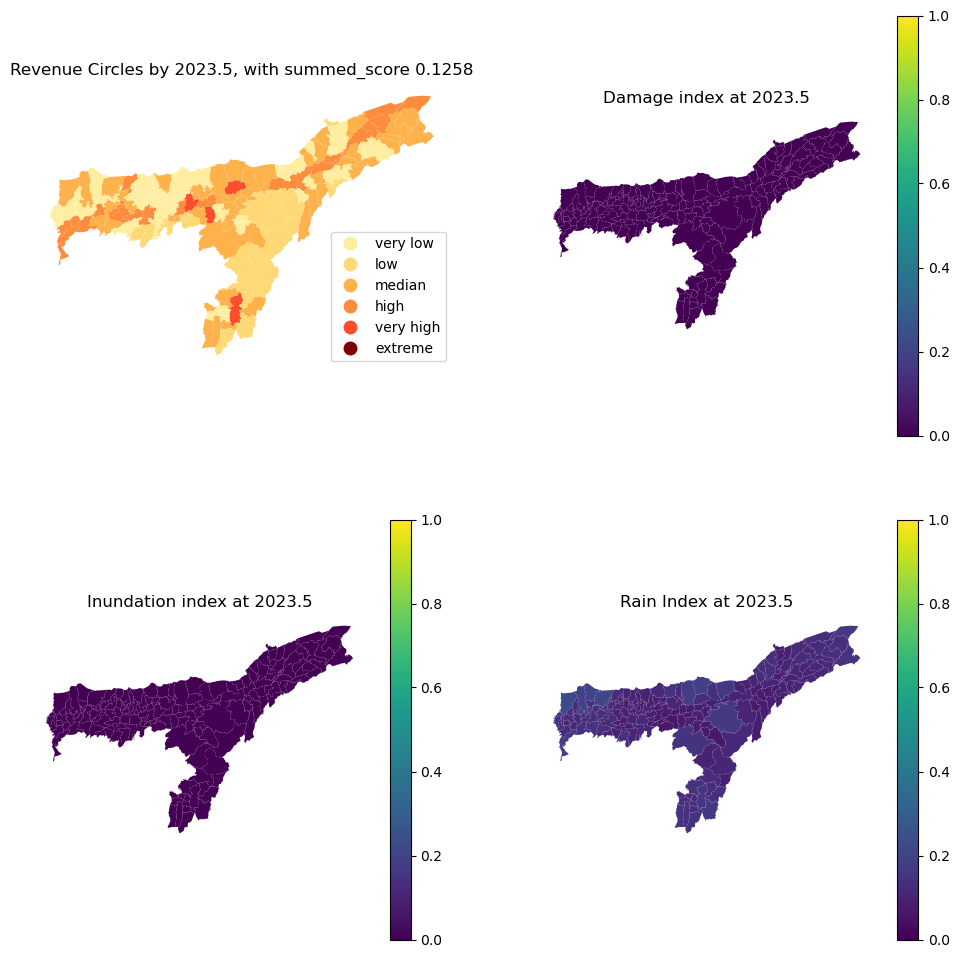

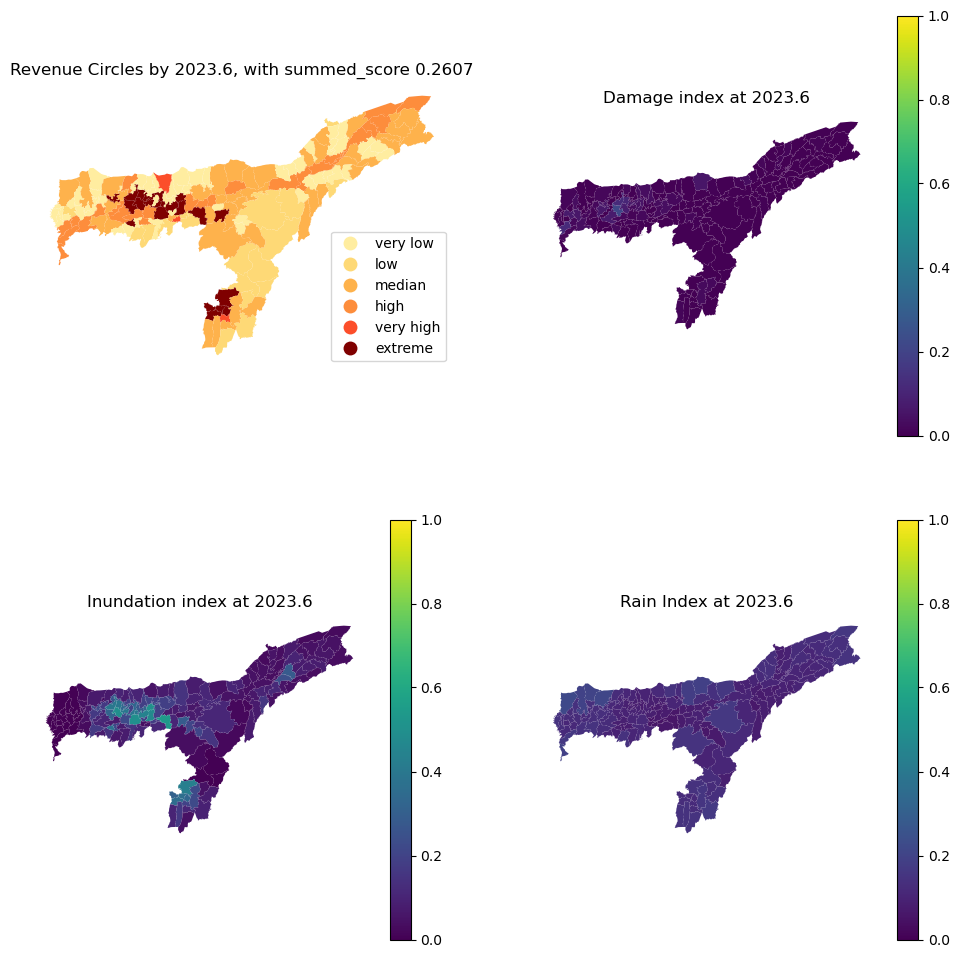

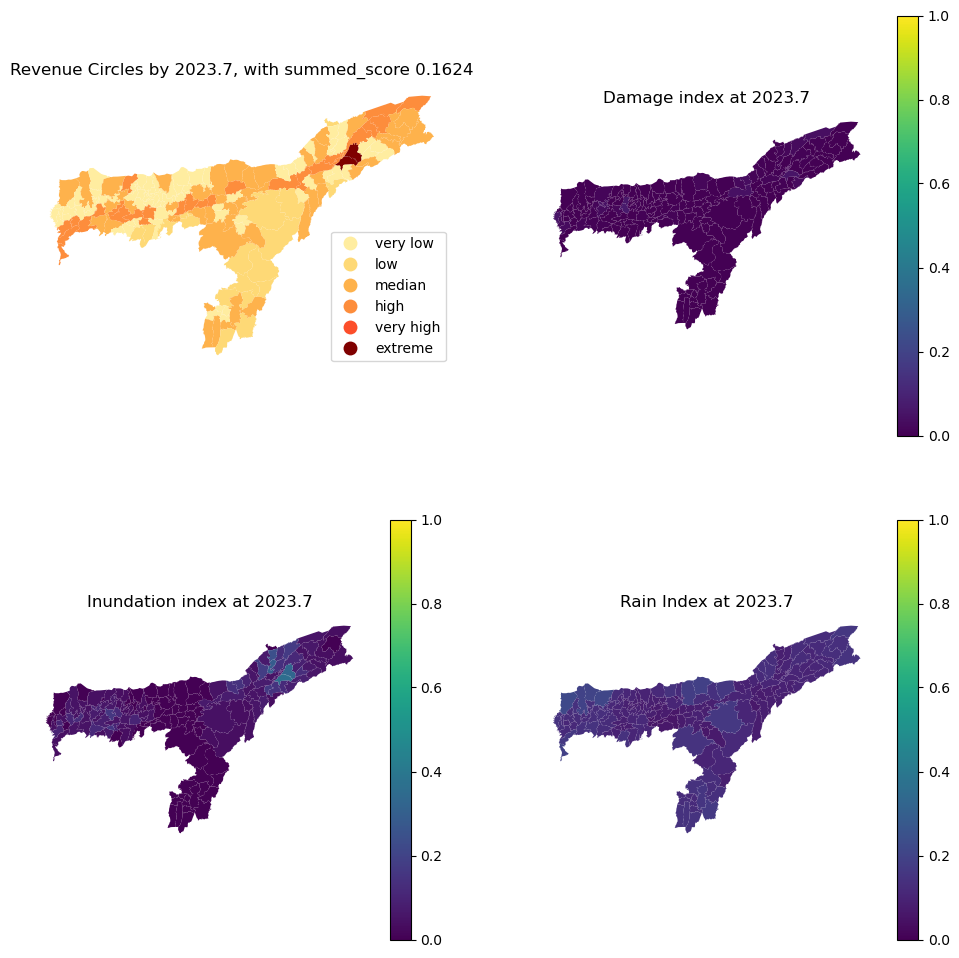

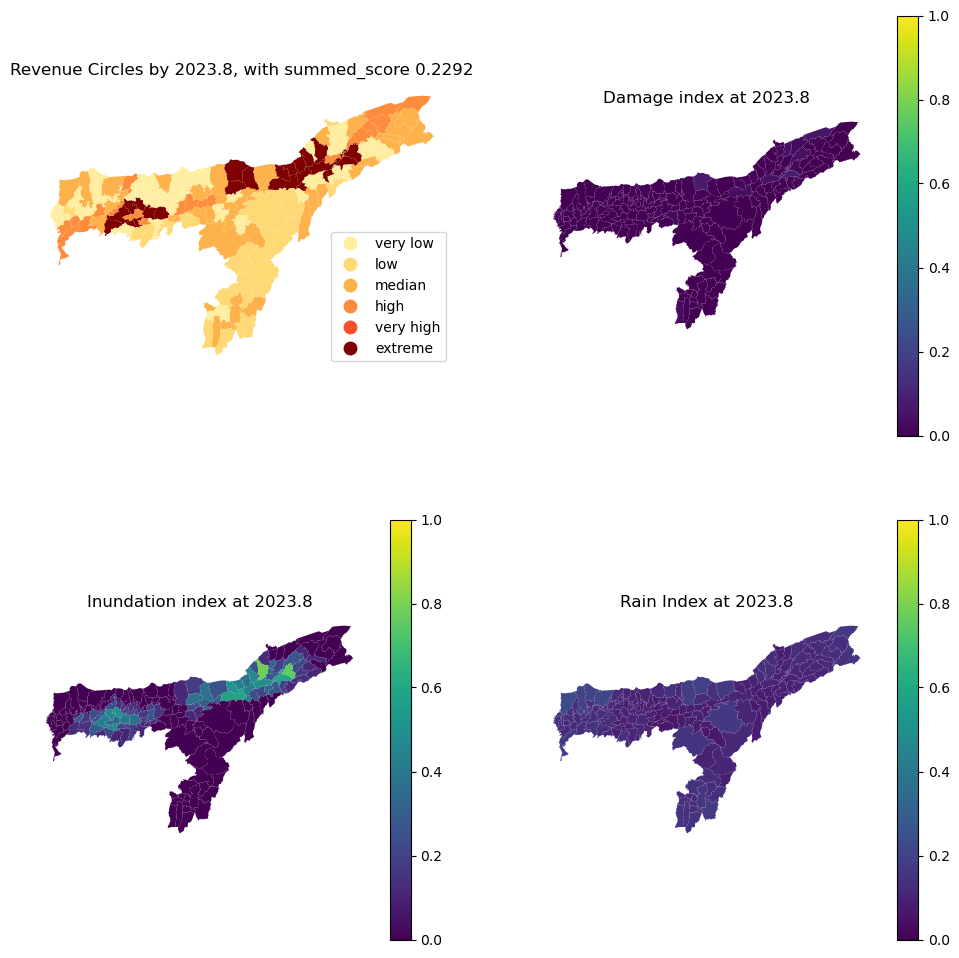

In [16]:
# Calculate min and max values for each index for normalization in plots
min_inundation_index = np.min(merged_data['inundation_index'])
max_inundation_index = np.max(merged_data['inundation_index'])
min_damage_index = np.min(merged_data['damage_index'])
max_damage_index = np.max(merged_data['damage_index'])
min_rain_index = np.min(merged_data['rain_index'])
max_rain_index = np.max(merged_data['rain_index'])

# Define function to draw index-related maps
def draw_index(data, object_id, index, year, month, classification_axis):
    # Load geographic data
    gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
    # Convert input data to DataFrame
    df = pd.DataFrame(data)
    # Ensure data types match for merging
    gdf[object_id] = gdf[object_id].astype(df[object_id].dtype)
    # Merge geographic data with input data
    gdf_merged = gdf.merge(df, on=object_id, how='left')

    # Set up risk categories and colormap
    categories = [0, 1, 2, 3, 4, 5, 6]
    labels = ['very low', 'low', 'median', 'high', 'very high', 'extreme']
    cmap = colors.ListedColormap(['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#7F0000'])
    norm = colors.BoundaryNorm(boundaries=categories, ncolors=len(categories))

    # Categorize risk levels
    gdf_merged['risk_category'] = pd.Categorical(pd.cut(gdf_merged[index],
                                                        bins=[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5],
                                                        labels=labels,
                                                        include_lowest=True,
                                                        ordered=True))
    # Create subplots for different indices
    fig, ax = plt.subplots(2, 2, figsize=(12, 12))
    # Plot risk category map
    gdf_merged.plot(column='risk_category', ax=ax[0][0], legend=True, cmap=cmap, norm=norm, legend_kwds={'loc': 'lower right'})
    ax[0][0].set_title(f"Revenue Circles by {year}.{month}, with {classification_axis} {round(np.mean(data[classification_axis]), 4)}")
    ax[0][0].set_axis_off()

    # Plot damage index map
    gdf_merged.plot(column='damage_index', ax=ax[0][1], legend=True, vmin=min_damage_index, vmax=max_damage_index)
    ax[0][1].set_title(f"Damage index at {year}.{month}")
    ax[0][1].set_axis_off()

    # Plot inundation index map
    gdf_merged.plot(column='inundation_index', ax=ax[1][0], legend=True, vmin=min_inundation_index, vmax=max_inundation_index)
    ax[1][0].set_title(f"Inundation index at {year}.{month}")
    ax[1][0].set_axis_off()

    # Plot rain index map
    gdf_merged.plot(column='rain_index', ax=ax[1][1], legend=True, vmin=min_rain_index, vmax=max_rain_index)
    ax[1][1].set_title(f"Rain Index at {year}.{month}")
    ax[1][1].set_axis_off()


# Loop through years and months to draw index maps
for year in [2021, 2022, 2023]:
    for month in range(1, 13):
        # Filter data for specific year and month
        filtered_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        # Check if there is data to plot
        if filtered_data.shape[0] > 0:
            draw_index(filtered_data, 'object_id', 'flood_index_adjusted', year, month, classification_axis)


# Draw Flood index and inundation-related variables to douoble check inundation_index and flood index

/var/folders/nj/g620cq492w98l83np35pmxb00000gn/T/ipykernel_9293/2822071396.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 2, figsize=(12, 12))


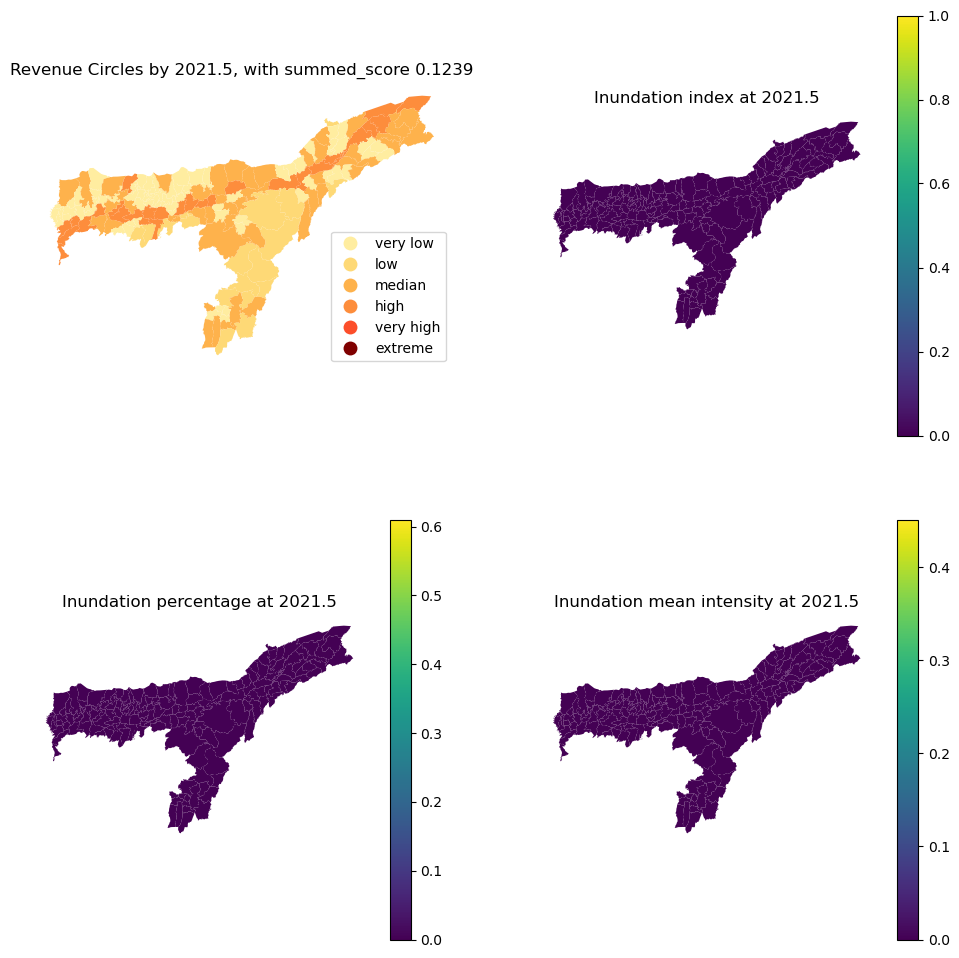

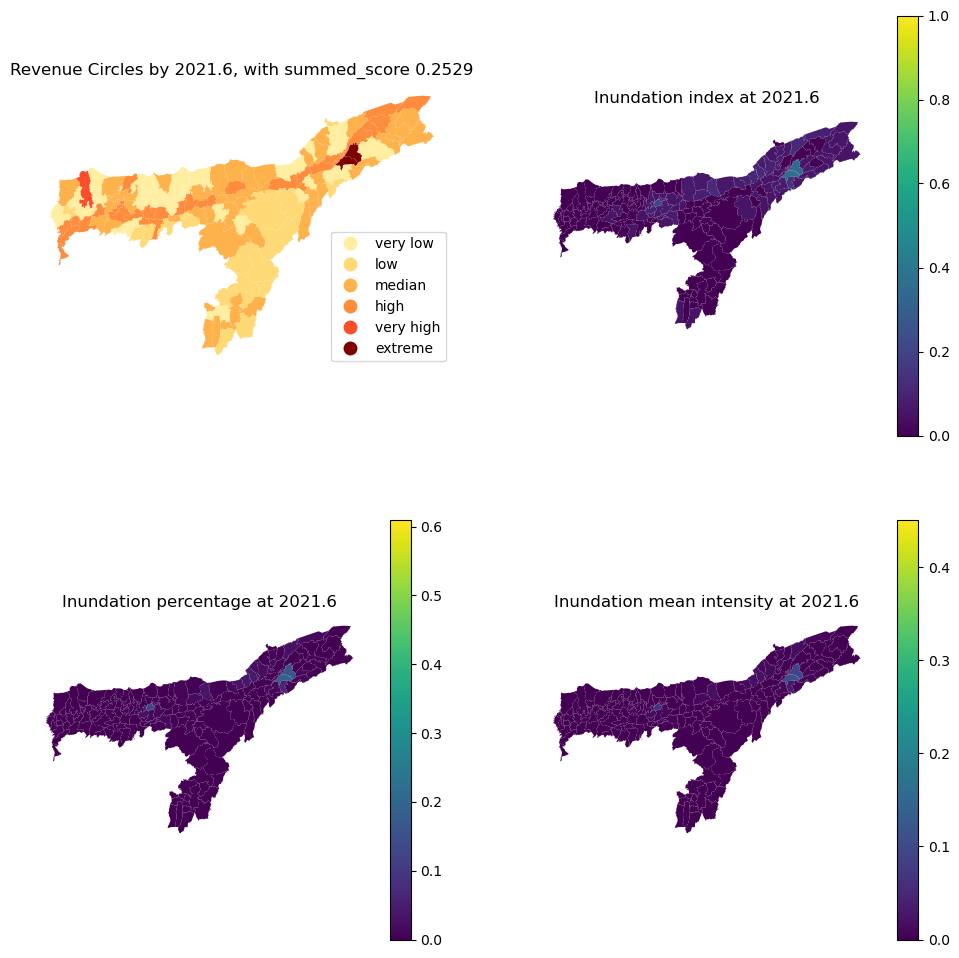

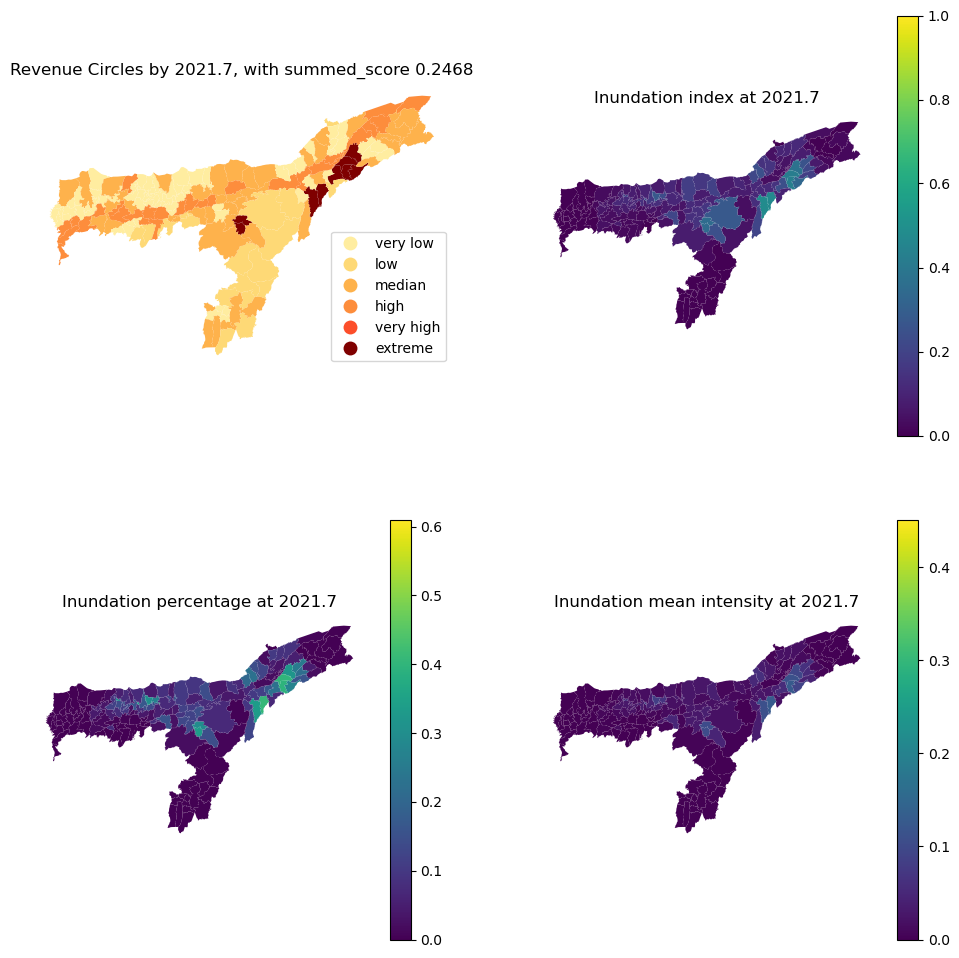

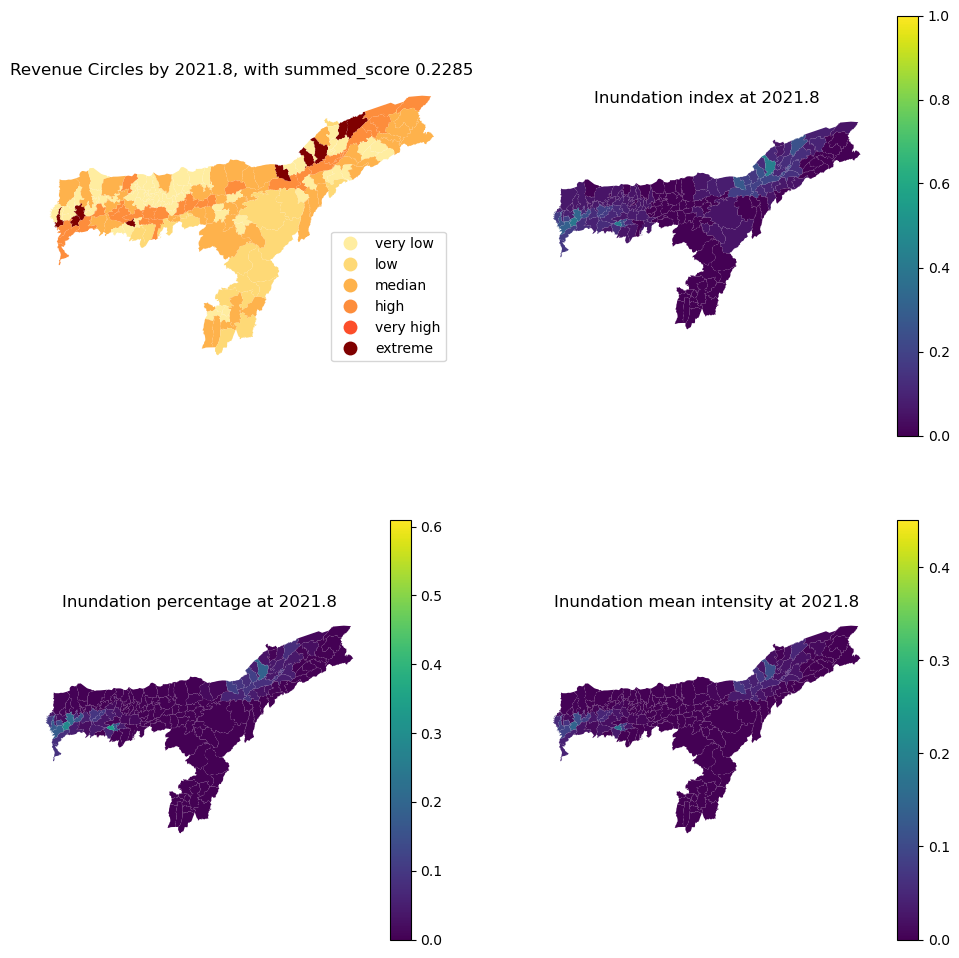

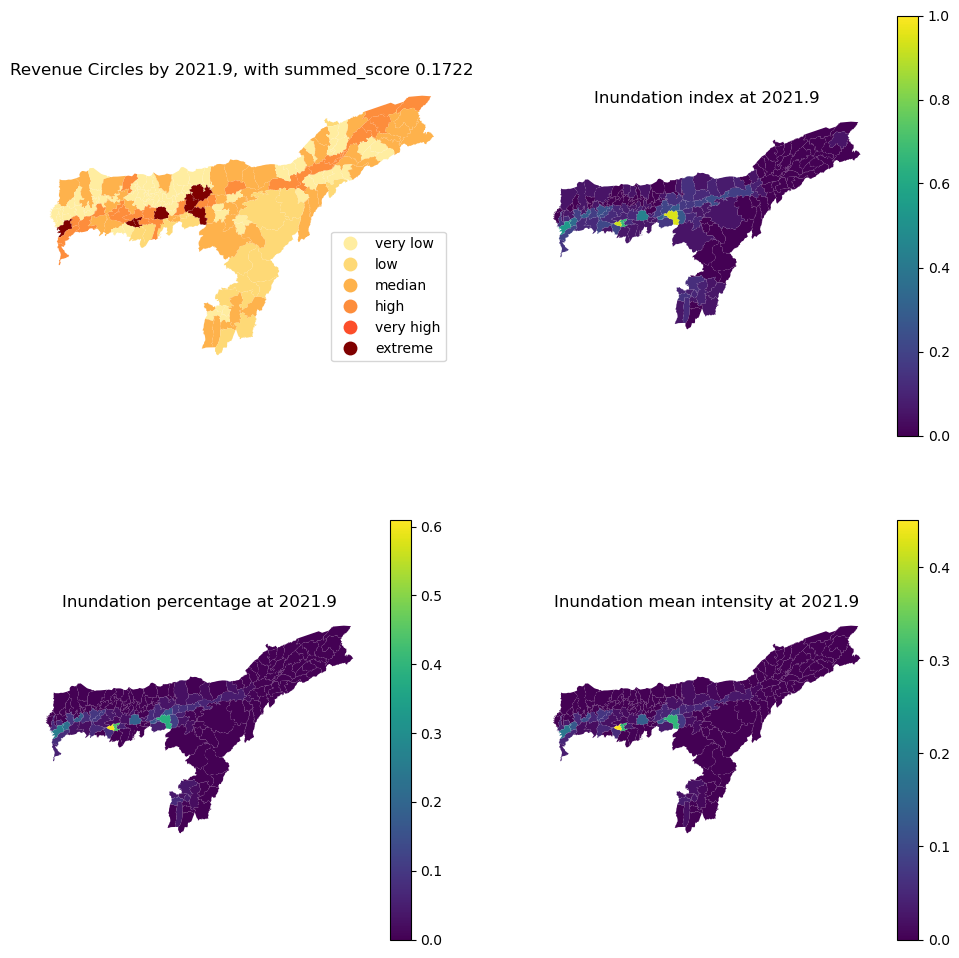

...

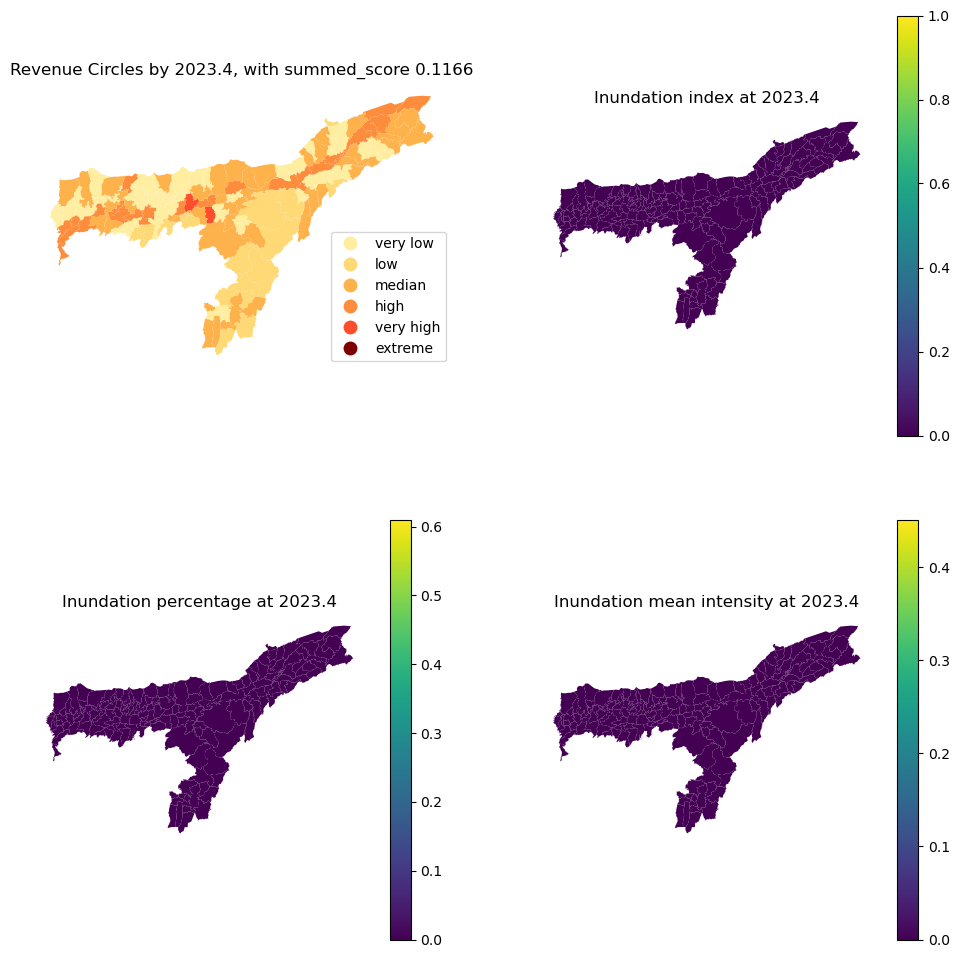

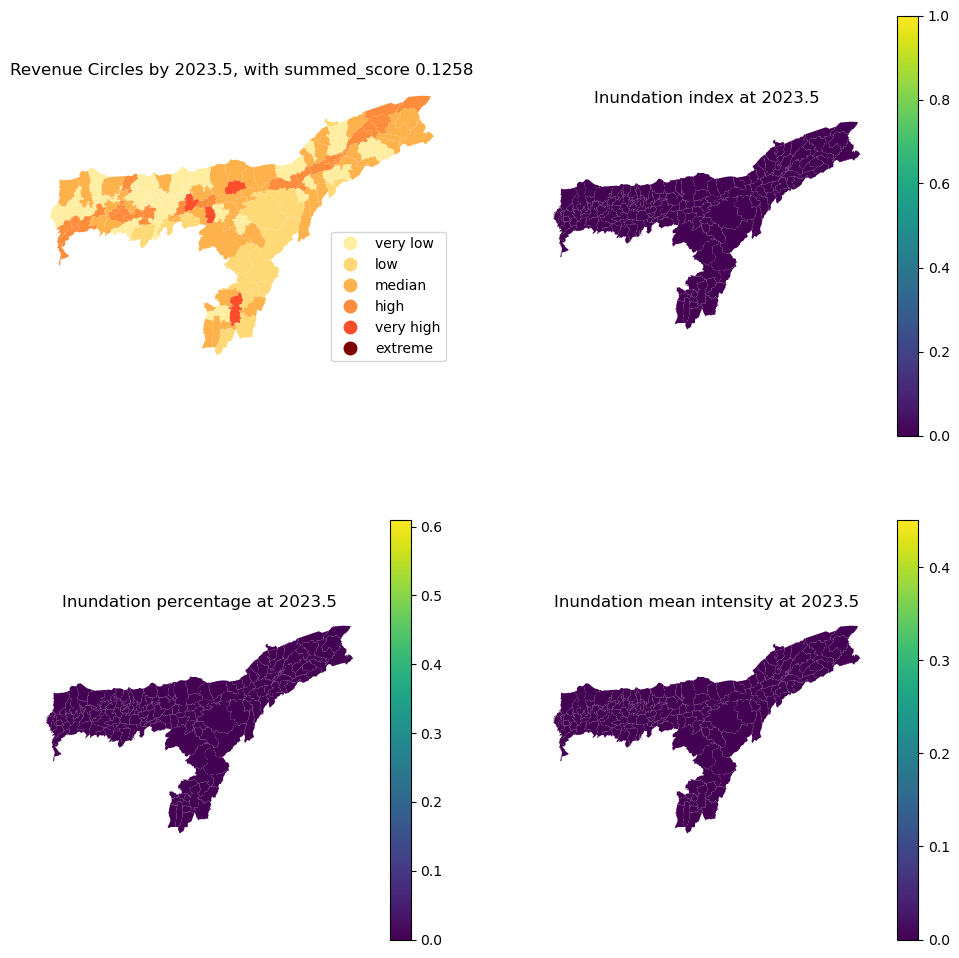

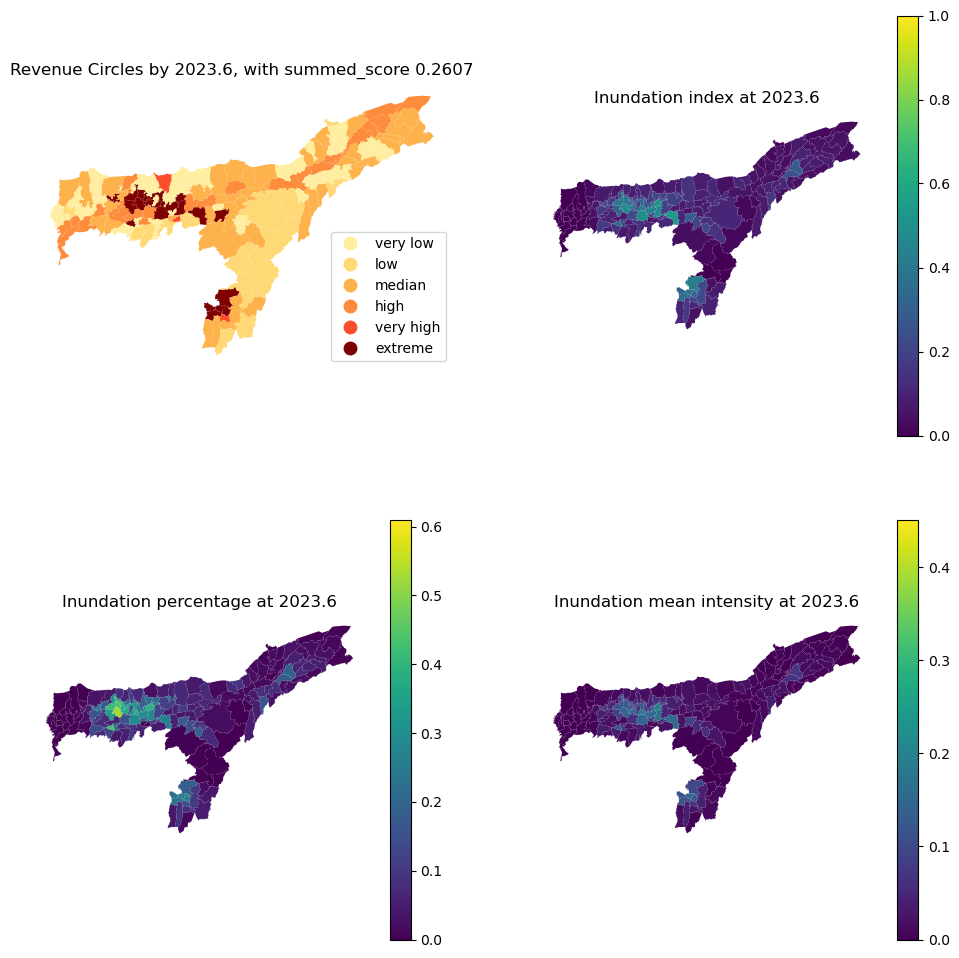

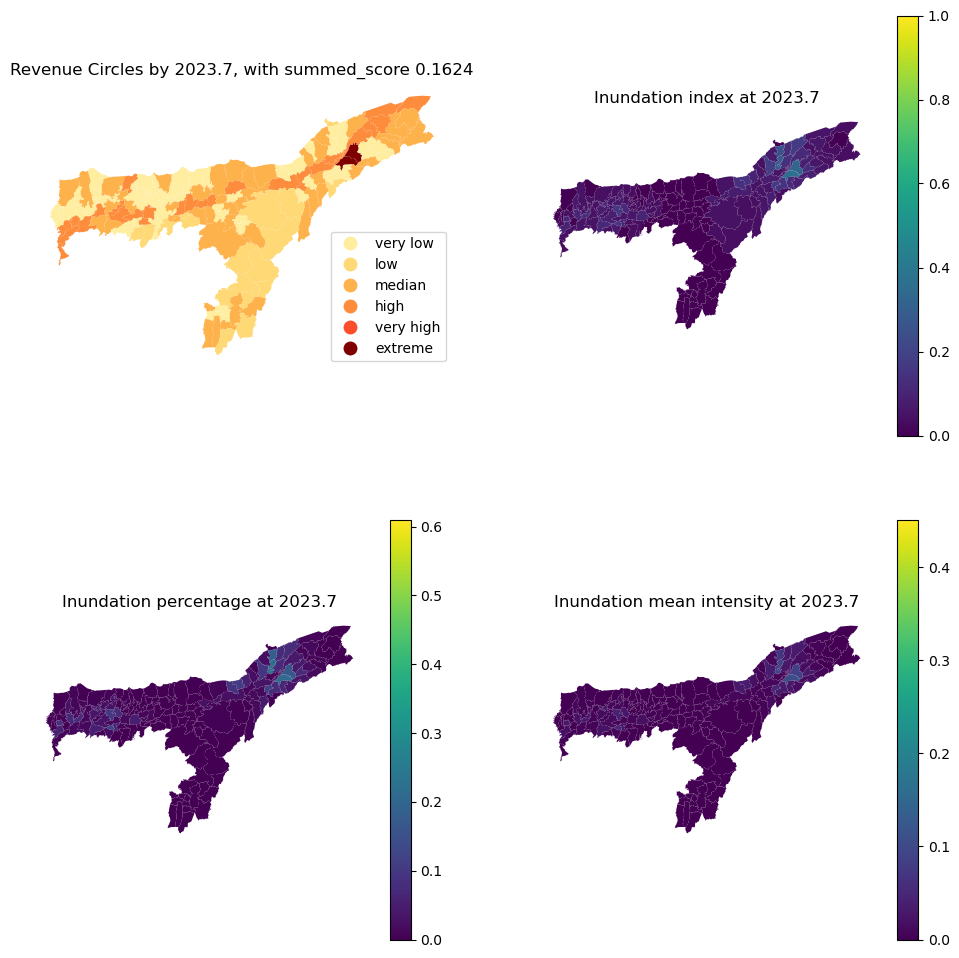

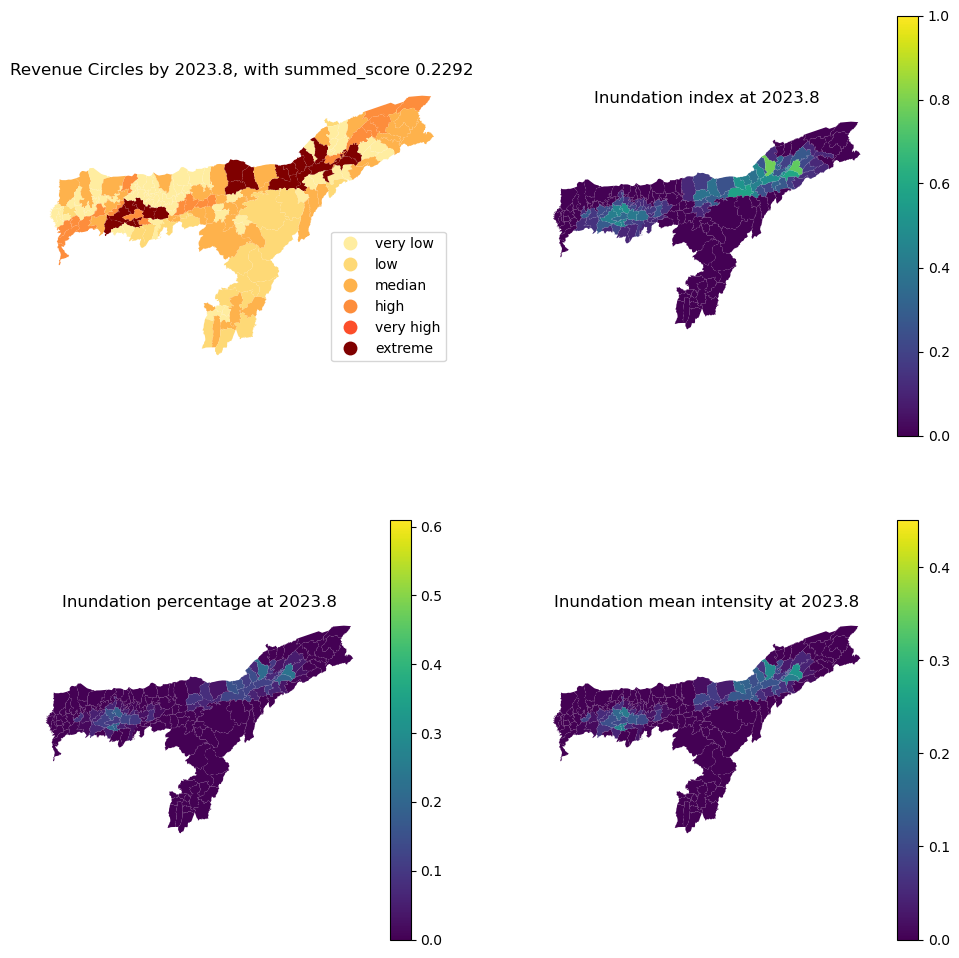

In [17]:
# Calculate minimum and maximum values for inundation-related variables
min_inundation_pct = np.min(merged_data['inundation_pct'])
max_inundation_pct = np.max(merged_data['inundation_pct'])
min_inundation_intensity_mean = np.min(merged_data['inundation_intensity_mean'])
max_inundation_intensity_mean = np.max(merged_data['inundation_intensity_mean'])

# Define function to draw inundation-related maps
def draw_inundation(data, object_id, index, year, month, classification_axis):
    # Load geographic data
    gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
    # Convert input data to DataFrame
    df = pd.DataFrame(data)
    # Ensure data types match for merging
    gdf[object_id] = gdf[object_id].astype(df[object_id].dtype)
    # Merge geographic data with input data
    gdf_merged = gdf.merge(df, on=object_id, how='left')

    # Set up risk categories and colormap
    categories = [0, 1, 2, 3, 4, 5, 6]
    labels = ['very low', 'low', 'median', 'high', 'very high', 'extreme']
    cmap = colors.ListedColormap(['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#7F0000'])
    norm = colors.BoundaryNorm(boundaries=categories, ncolors=len(categories))

    # Categorize risk levels
    gdf_merged['risk_category'] = pd.Categorical(pd.cut(gdf_merged[index],
                                                        bins=[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5],
                                                        labels=labels,
                                                        include_lowest=True,
                                                        ordered=True))
    # Create subplots for different inundation aspects
    fig, ax = plt.subplots(2, 2, figsize=(12, 12))
    # Plot risk category map
    gdf_merged.plot(column='risk_category', ax=ax[0][0], legend=True, cmap=cmap, norm=norm, legend_kwds={'loc': 'lower right'})
    ax[0][0].set_title(f"Revenue Circles by {year}.{month}, with {classification_axis} {round(np.mean(data[classification_axis]), 4)}")
    ax[0][0].set_axis_off()

    # Plot inundation index map
    gdf_merged.plot(column='inundation_index', ax=ax[0][1], legend=True, vmin=min_inundation_index, vmax=max_inundation_index)
    ax[0][1].set_title(f"Inundation index at {year}.{month}")
    ax[0][1].set_axis_off()

    # Plot inundation percentage map
    gdf_merged.plot(column='inundation_pct', ax=ax[1][0], legend=True, vmin=min_inundation_pct, vmax=max_inundation_pct)
    ax[1][0].set_title(f"Inundation percentage at {year}.{month}")
    ax[1][0].set_axis_off()

    # Plot inundation mean intensity map
    gdf_merged.plot(column='inundation_intensity_mean', ax=ax[1][1], legend=True, vmin=min_inundation_intensity_mean, vmax=max_inundation_intensity_mean)
    ax[1][1].set_title(f"Inundation mean intensity at {year}.{month}")
    ax[1][1].set_axis_off()

# Loop through years and months to draw inundation maps
for year in [2021, 2022, 2023]:
    for month in range(1, 13):
        # Filter data for specific year and month
        filtered_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        # Check if there is data to plot
        if filtered_data.shape[0] > 0:
            draw_inundation(filtered_data, 'object_id', 'flood_index_adjusted', year, month, classification_axis)


# Draw Flood index and rain-related variables to douoble check rain_index and flood index

/var/folders/nj/g620cq492w98l83np35pmxb00000gn/T/ipykernel_9293/144044328.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 2, figsize=(12, 12))


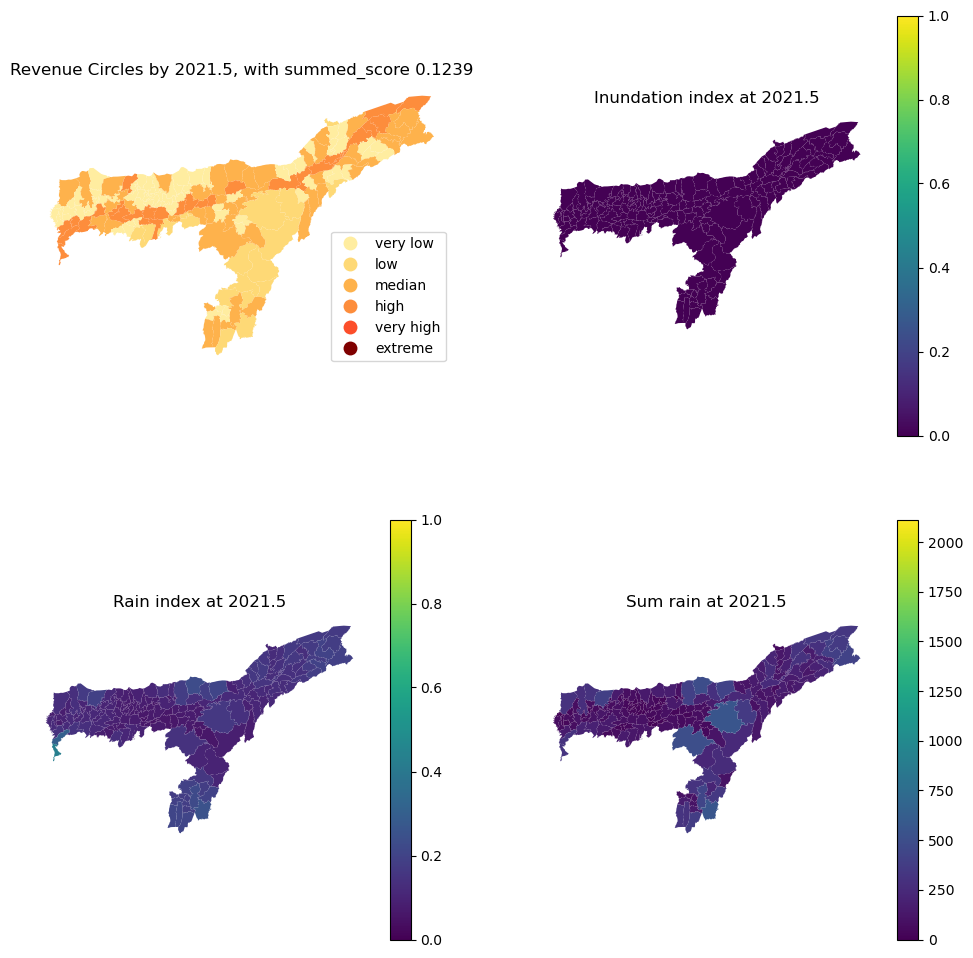

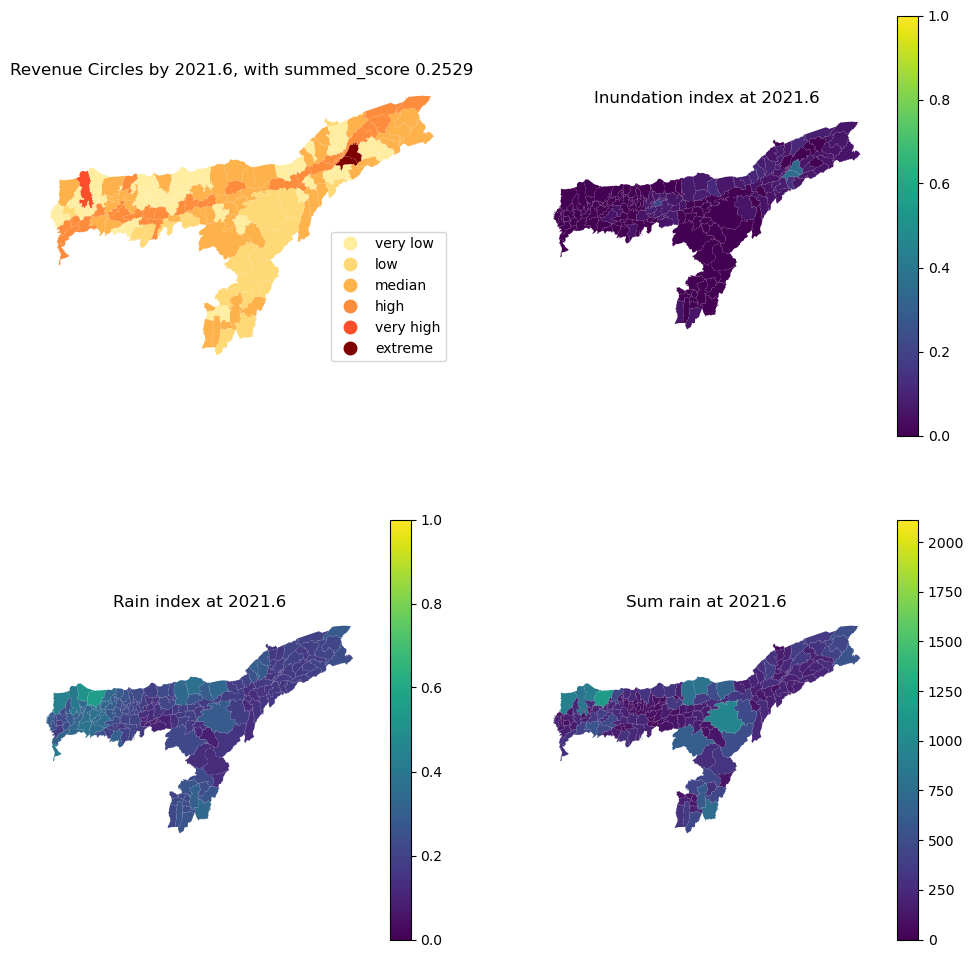

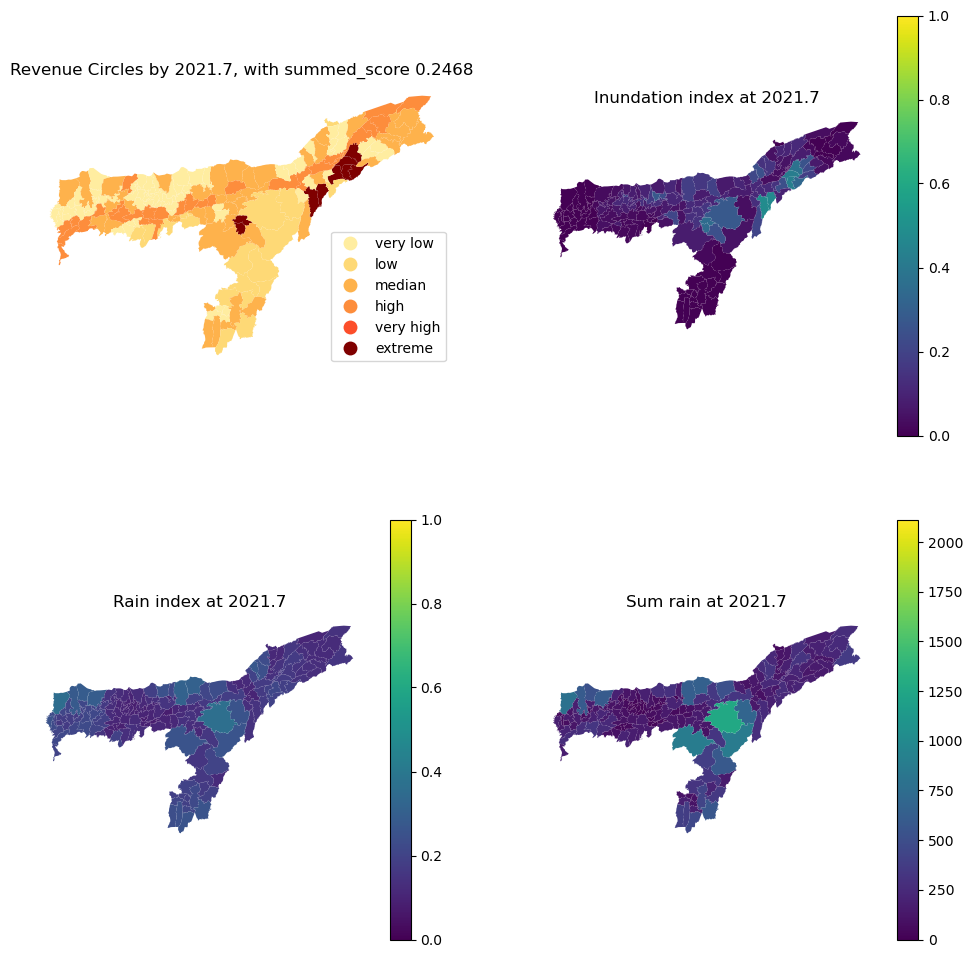

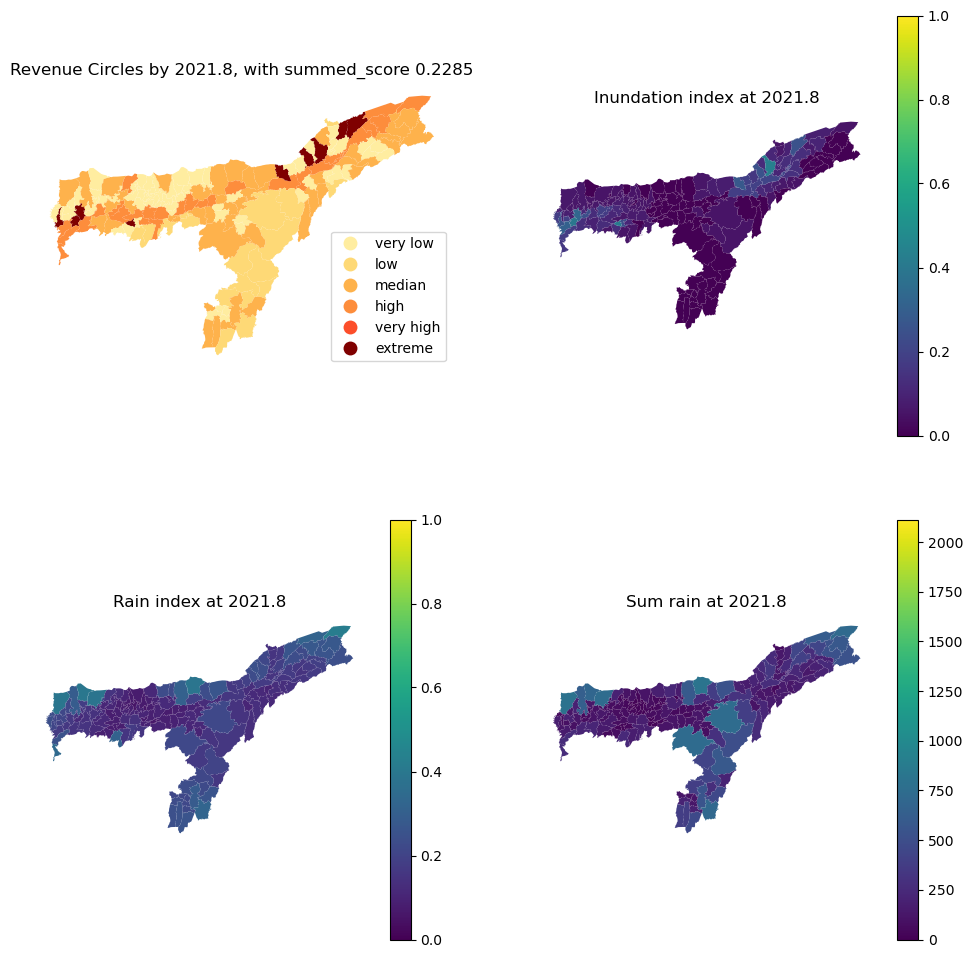

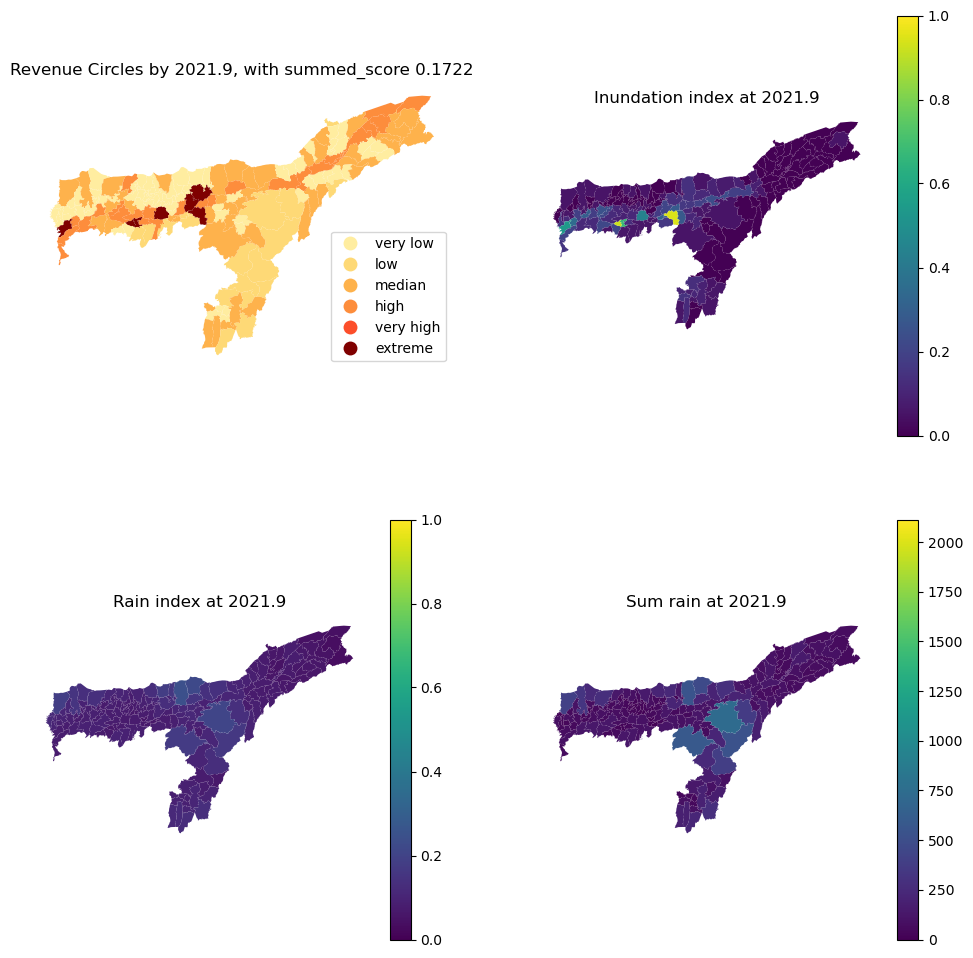

...

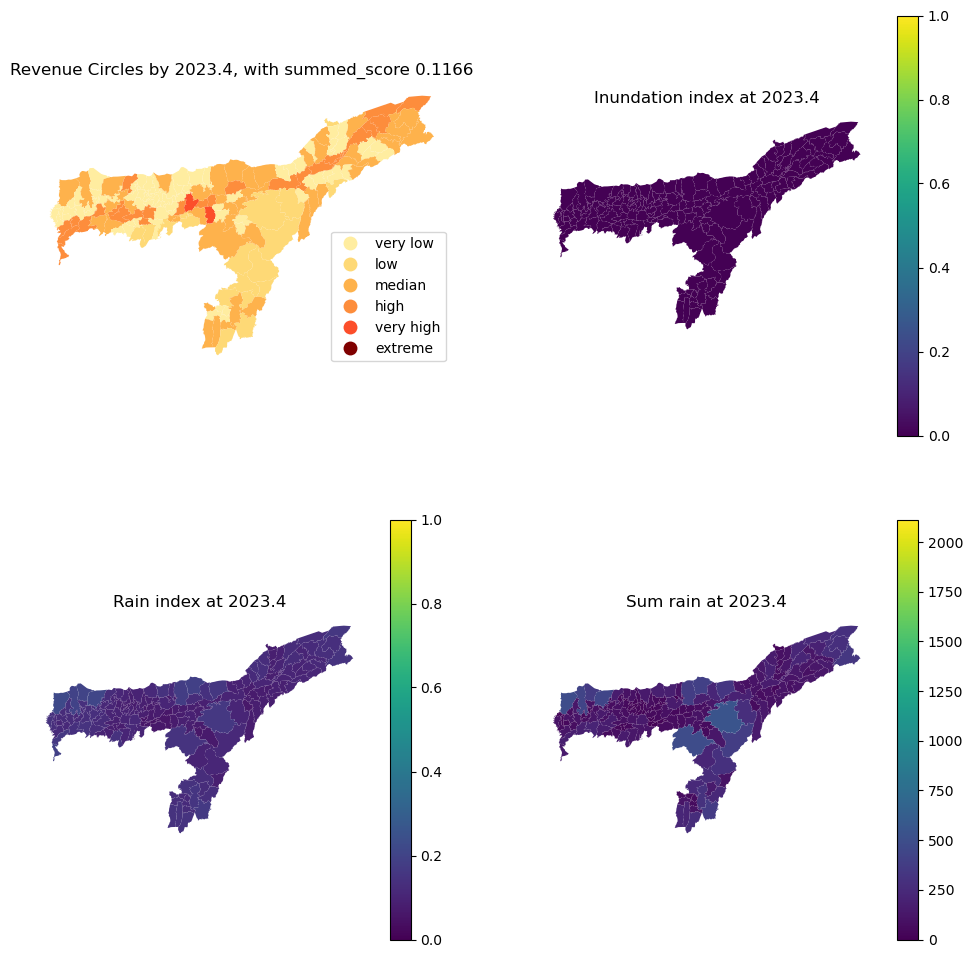

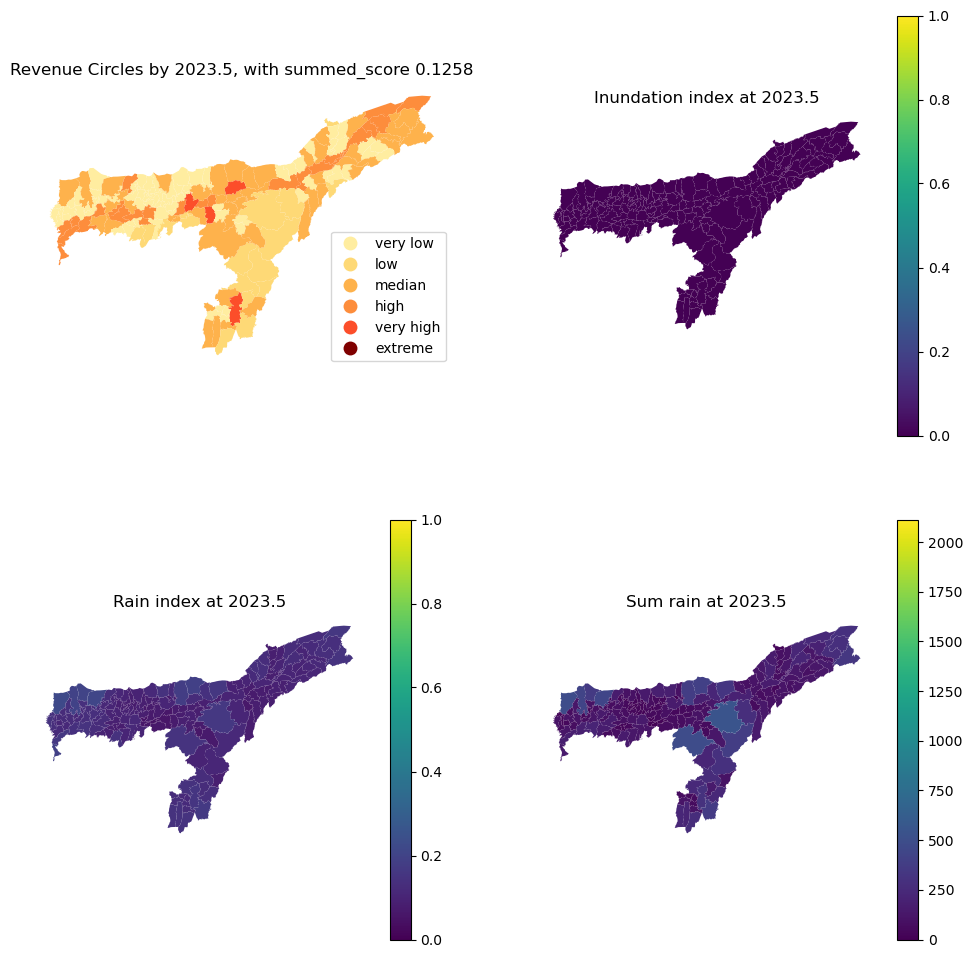

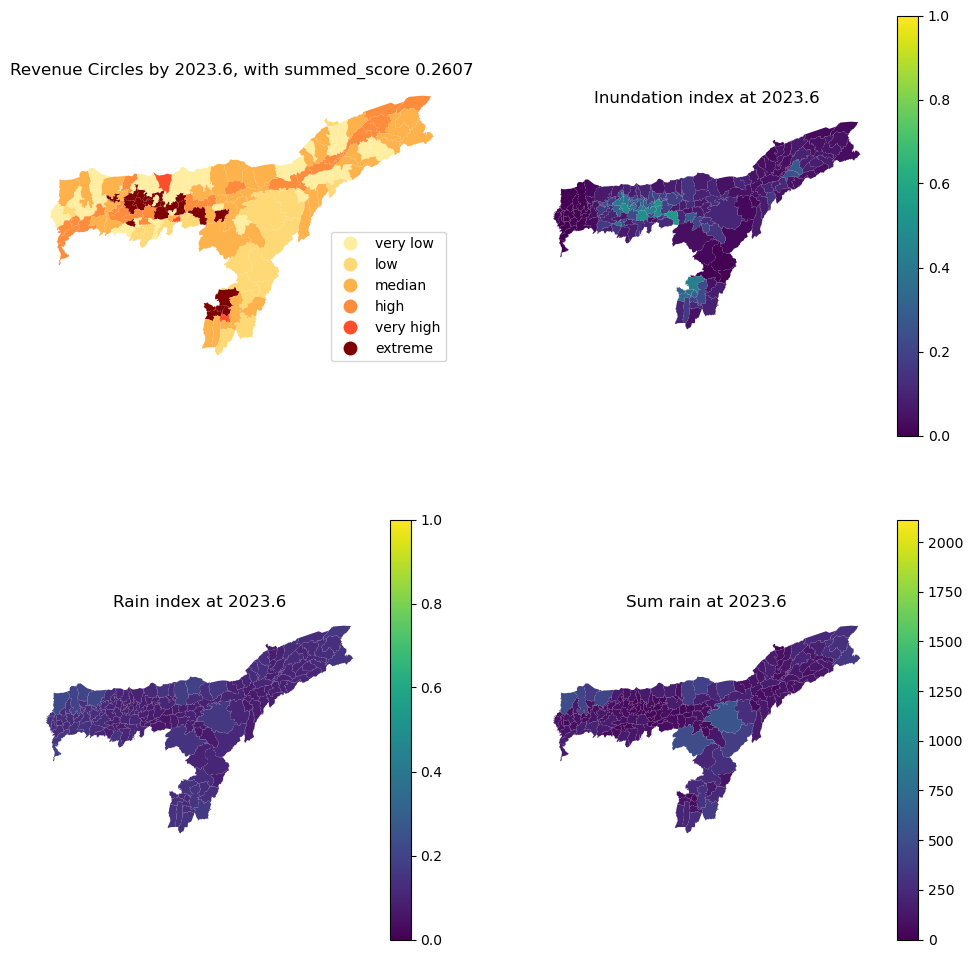

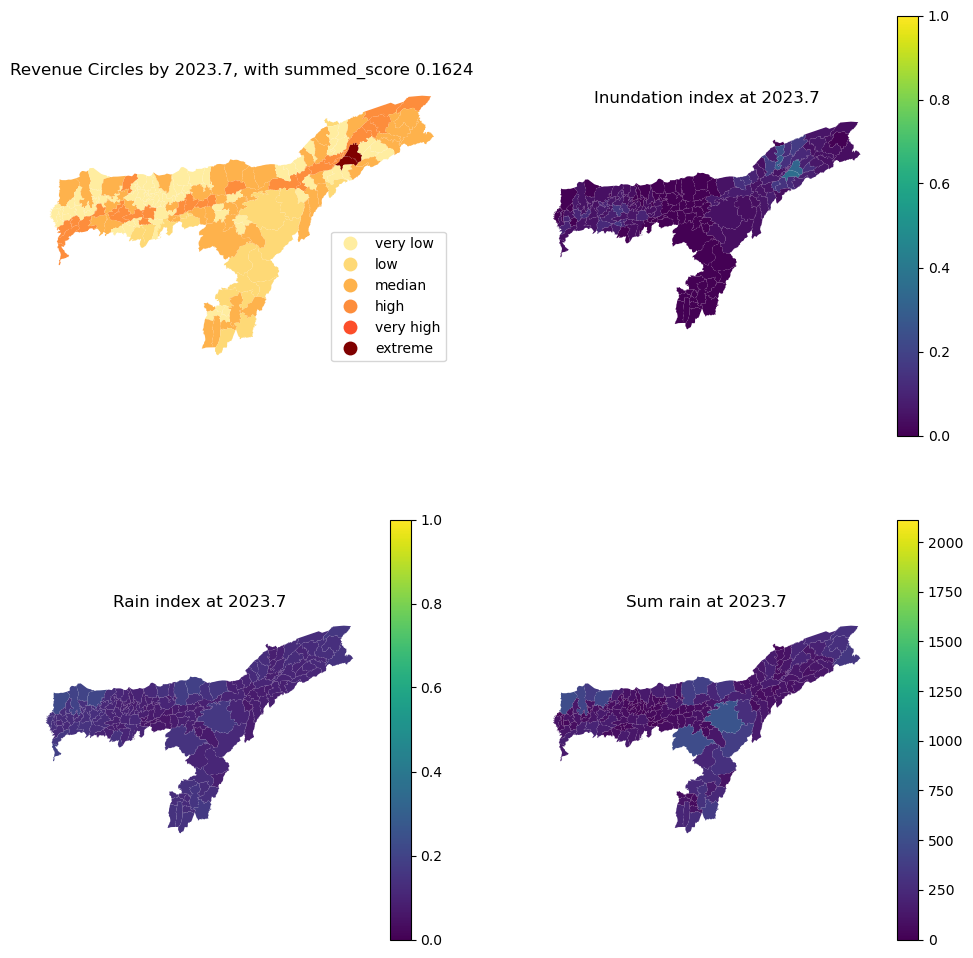

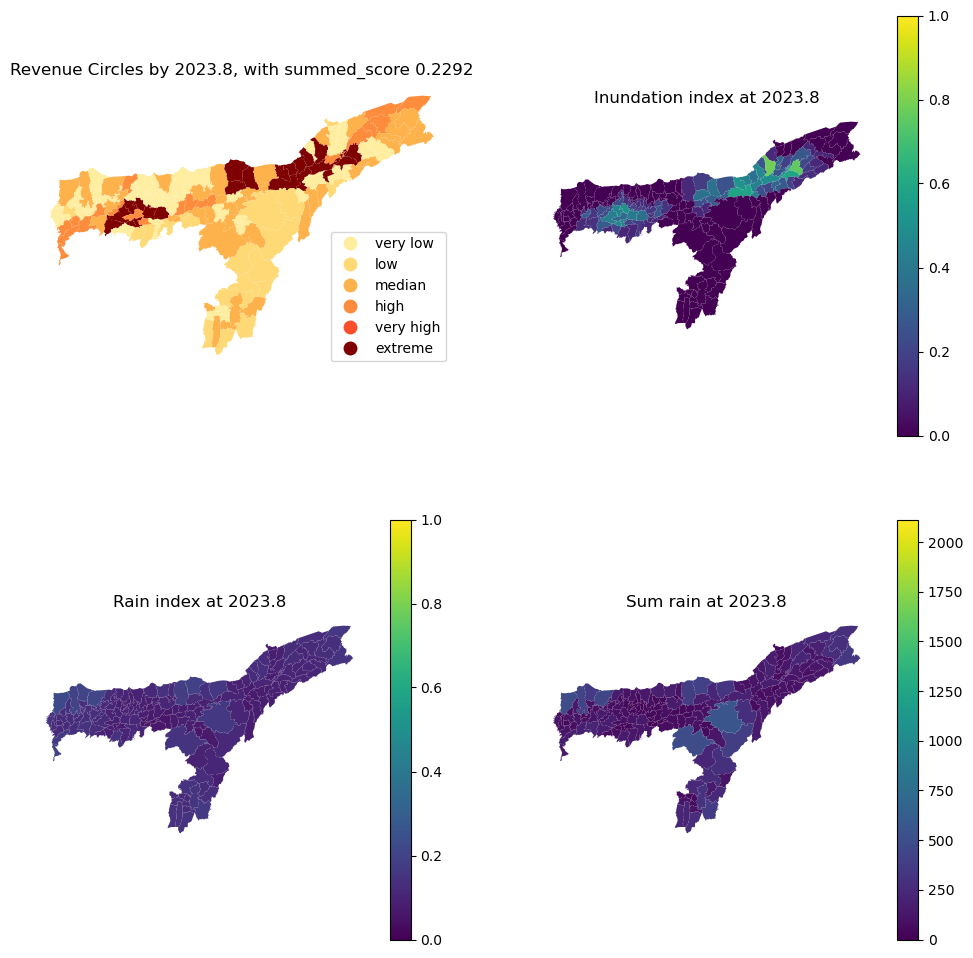

In [18]:
# Calculate minimum and maximum values for total rainfall
min_sum_rain = np.min(merged_data['sum_rain'])
max_sum_rain = np.max(merged_data['sum_rain'])

# Define function to draw rain-related maps
def draw_rain(data, object_id, index, year, month, classification_axis):
    # Load geographic data
    gdf = gpd.read_file("assam_revenue_circles_nov2022_4326.geojson")
    # Convert input data to DataFrame
    df = pd.DataFrame(data)
    # Ensure data types match for merging
    gdf[object_id] = gdf[object_id].astype(df[object_id].dtype)
    # Merge geographic data with input data
    gdf_merged = gdf.merge(df, on=object_id, how='left')

    # Set up risk categories and colormap
    categories = [0, 1, 2, 3, 4, 5, 6]
    labels = ['very low', 'low', 'median', 'high', 'very high', 'extreme']
    cmap = colors.ListedColormap(['#FFEDA0', '#FED976', '#FEB24C', '#FD8D3C', '#FC4E2A', '#7F0000'])
    norm = colors.BoundaryNorm(boundaries=categories, ncolors=len(categories))

    # Categorize risk levels
    gdf_merged['risk_category'] = pd.Categorical(pd.cut(gdf_merged[index],
                                                        bins=[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5],
                                                        labels=labels,
                                                        include_lowest=True,
                                                        ordered=True))
    # Create subplots for different rain aspects
    fig, ax = plt.subplots(2, 2, figsize=(12, 12))
    # Plot risk category map
    gdf_merged.plot(column='risk_category', ax=ax[0][0], legend=True, cmap=cmap, norm=norm, legend_kwds={'loc': 'lower right'})
    ax[0][0].set_title(f"Revenue Circles by {year}.{month}, with {classification_axis} {round(np.mean(data[classification_axis]), 4)}")
    ax[0][0].set_axis_off()

    # Plot inundation index map
    gdf_merged.plot(column='inundation_index', ax=ax[0][1], legend=True, vmin=min_inundation_index, vmax=max_inundation_index)
    ax[0][1].set_title(f"Inundation index at {year}.{month}")
    ax[0][1].set_axis_off()

    # Plot rain index map
    gdf_merged.plot(column='rain_index', ax=ax[1][0], legend=True, vmin=min_rain_index, vmax=max_rain_index)
    ax[1][0].set_title(f"Rain index at {year}.{month}")
    ax[1][0].set_axis_off()

    # Plot total rainfall map
    gdf_merged.plot(column='sum_rain', ax=ax[1][1], legend=True, vmin=min_sum_rain, vmax=max_sum_rain)
    ax[1][1].set_title(f"Sum rain at {year}.{month}")
    ax[1][1].set_axis_off()

# Loop through years and months to draw rain maps
for year in [2021, 2022, 2023]:
    for month in range(1, 13):
        # Filter data for specific year and month
        filtered_data = merged_data[(merged_data['year'] == year) & (merged_data['month'] == month)]
        # Check if there is data to plot
        if filtered_data.shape[0] > 0:
            draw_rain(filtered_data, 'object_id', 'flood_index_adjusted', year, month, classification_axis)
